In [2]:
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import VarianceThreshold
from sklearn.preprocessing import StandardScaler
import numpy as np
from pyclustering.cluster.kmedoids import kmedoids
import seaborn as sns
import matplotlib.pyplot as plt
from pyclustering.cluster.kmedoids import kmedoids
from mrmr import mrmr_regression
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.feature_selection import SelectKBest, f_regression, SelectFdr
from scipy.cluster.hierarchy import linkage, fcluster
from scipy.spatial.distance import squareform

import joblib
import missingno as msno
import numpy as np
from scipy.stats import shapiro
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.datasets import load_diabetes, load_iris
from sklearn.linear_model import LinearRegression
from sklearn.metrics import root_mean_squared_error

from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer




In [3]:
RadiomicsFeaturesresults_main = pd.read_csv("/home/pansurya/OSIC_thesis/radiomics_files/RadiomicsFeaturesresults_main.csv")
# RadiomicsFeaturesresults_main = pd.read_csv("/home/pansurya/OSIC_thesis/radiomics_files/RadiomicsFeaturesresults2ROICovid_main.csv")
# RadiomicsFeaturesresults_main = pd.read_csv("/home/pansurya/OSIC_thesis/radiomics_files/RadiomicsFeaturesresults_harmonizedBYManufacturer.csv")
RadiomicsFeaturesresults_main.drop(columns=["BaselineDate", "SeriesUID","Image", "Mask"], inplace=True) #"SeriesUID"
RadiomicsFeaturesresults_main

,PatientID,original_shape_Elongation_right_lung,original_shape_Flatness_right_lung,original_shape_LeastAxisLength_right_lung,original_shape_MajorAxisLength_right_lung,original_shape_Maximum2DDiameterColumn_right_lung,original_shape_Maximum2DDiameterRow_right_lung,original_shape_Maximum2DDiameterSlice_right_lung,original_shape_Maximum3DDiameter_right_lung,original_shape_MeshVolume_right_lung,...,log-sigma-5-0-mm-3D_gldm_LargeDependenceLowGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_LowGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_SmallDependenceEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_SmallDependenceHighGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_ngtdm_Busyness_left_lung,log-sigma-5-0-mm-3D_ngtdm_Coarseness_left_lung,log-sigma-5-0-mm-3D_ngtdm_Complexity_left_lung,log-sigma-5-0-mm-3D_ngtdm_Contrast_left_lung,log-sigma-5-0-mm-3D_ngtdm_Strength_left_lung
0,1001326,0.420187,0.130738,52.402080,400.816893,439.550907,184.458667,460.108683,475.458726,1.886126e+06,...,0.419370,0.002318,0.020310,9.428086,0.000051,39.586532,0.000022,229.595790,0.007051,0.017023
1,298078,0.831037,0.732034,129.431489,176.810734,246.916990,196.124960,185.000000,247.543935,2.056160e+06,...,0.584449,0.002190,0.018080,9.555249,0.000041,31.821433,0.000022,256.600569,0.005208,0.026229
2,727988,0.847265,0.639267,120.835834,189.022386,217.816436,238.824203,200.249844,250.710989,1.901542e+06,...,0.568999,0.002971,0.020283,8.182886,0.000066,27.788108,0.000030,281.030063,0.006183,0.030992
3,1001092,0.918112,0.553487,106.066920,191.634136,260.931025,229.386137,195.310010,267.845104,1.776213e+06,...,0.520253,0.002362,0.020223,9.843252,0.000052,31.931103,0.000025,248.334156,0.006476,0.023937
4,772512,0.815482,0.730328,132.707854,181.709883,232.422030,205.761998,193.080294,249.142529,2.065693e+06,...,0.453026,0.002081,0.022213,12.142016,0.000050,26.556077,0.000029,253.667054,0.007355,0.026741
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
549,884616,0.726119,0.484869,125.748118,259.344354,293.264386,208.081715,310.104821,313.972929,3.210182e+06,...,0.392122,0.001992,0.019201,10.399997,0.000044,32.889258,0.000022,258.723045,0.006163,0.021822
550,1000939,0.449398,0.126135,58.291219,462.135209,568.148748,217.082933,590.371070,592.218710,2.884371e+06,...,0.611136,0.003553,0.019442,6.304344,0.000075,59.092531,0.000022,169.130931,0.009339,0.011234
551,583963,0.881909,0.704290,161.614927,229.472190,289.689489,235.416652,282.793211,295.448811,4.013125e+06,...,0.365670,0.002657,0.024871,12.044779,0.000067,34.614121,0.000023,274.996828,0.007852,0.021883
552,1000731,0.695807,0.340087,82.987358,244.018123,277.504955,177.417587,332.031625,335.005970,1.664340e+06,...,0.552630,0.003359,0.017876,6.299518,0.000065,41.195646,0.000031,158.150503,0.009407,0.015823


In [4]:
#Clinical data
Clinical_demographic_data = pd.read_csv("/home/pansurya/OSIC_thesis/CSV_ Files/Clinical_demographic_data.csv")
Clinical_demographic_data.isna().sum()

Subject ID                0
Baseline FVC Volume L     0
Baseline FVC Week         0
Followup FVC Volume L     0
Followup FVC Week         0
Primary Diagnosis         0
Sex                       0
Age                       0
Smoking History           0
FEV1 Volume L             7
DLCO_CAP                 56
dtype: int64

<Axes: >

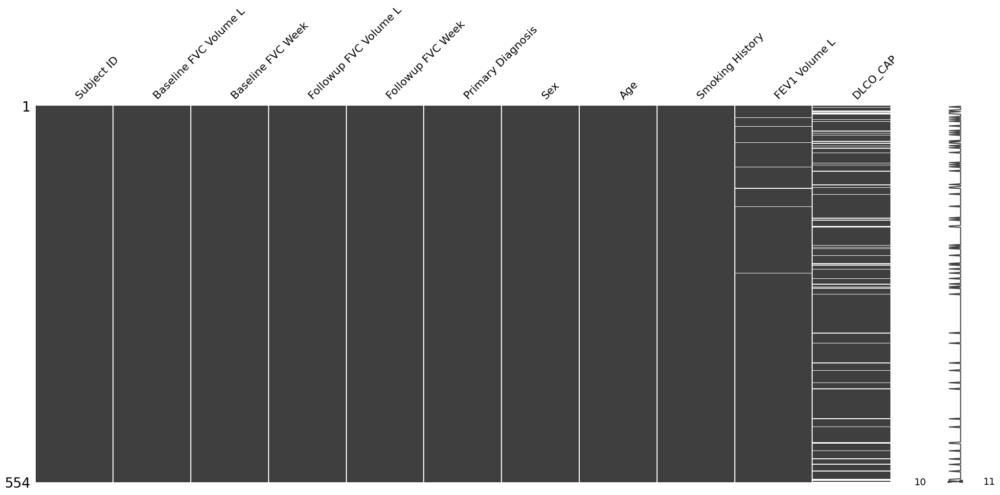

In [5]:
msno.matrix(Clinical_demographic_data)

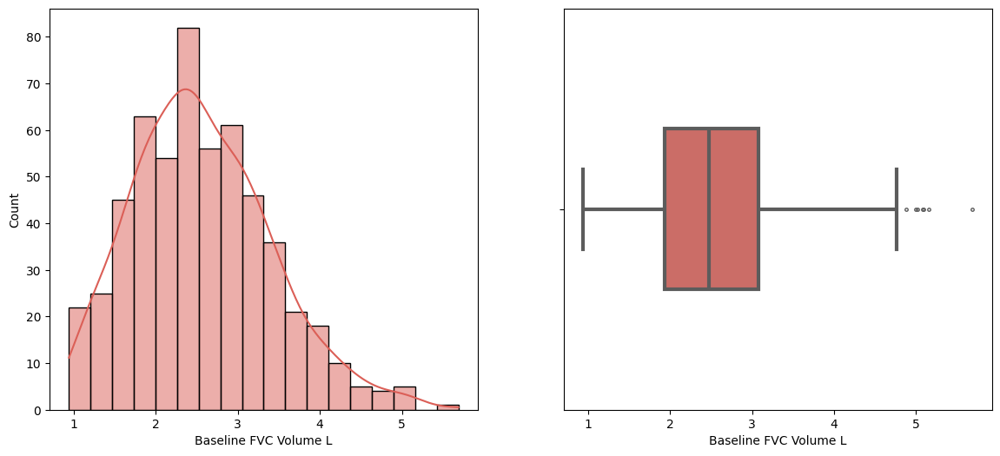

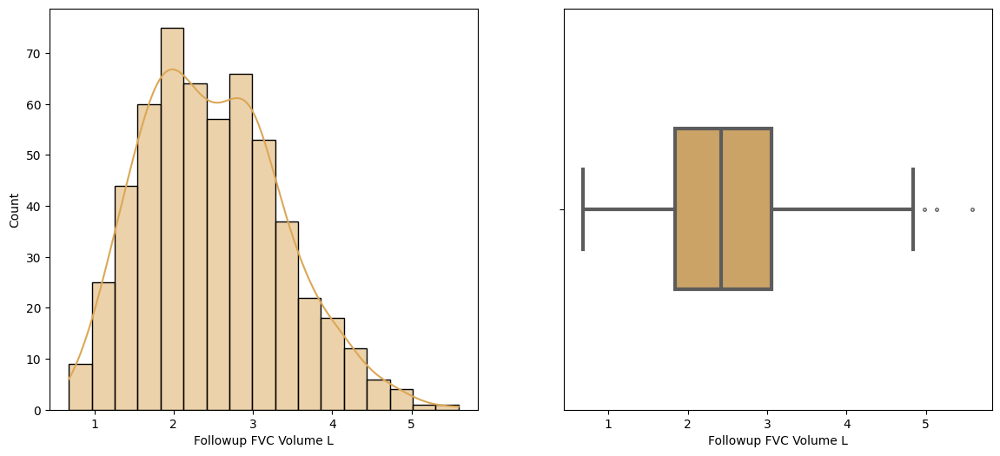

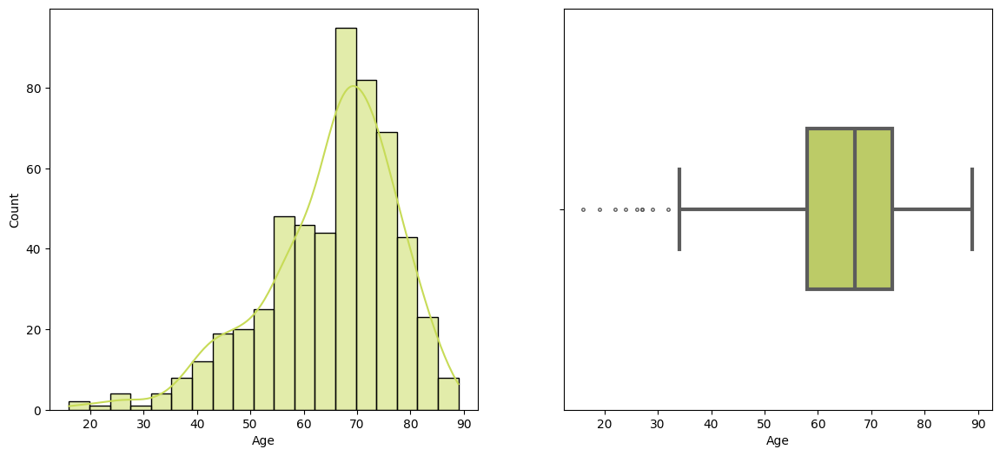

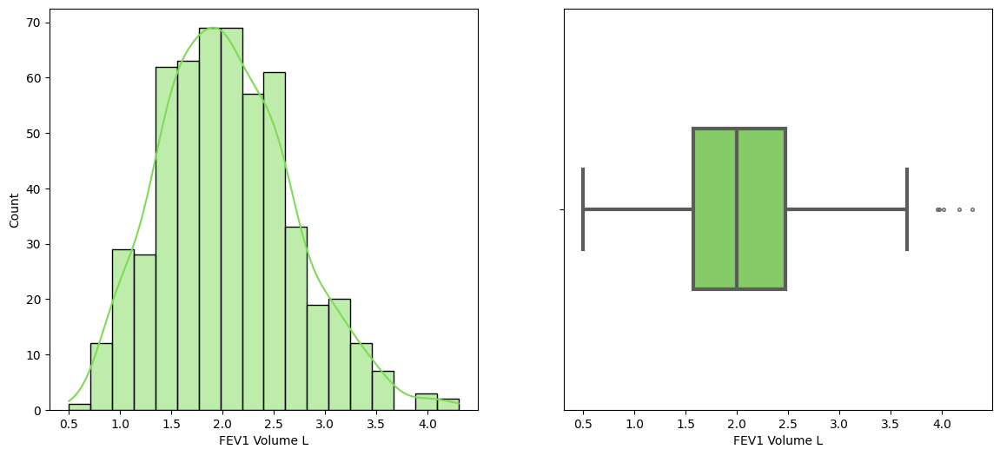

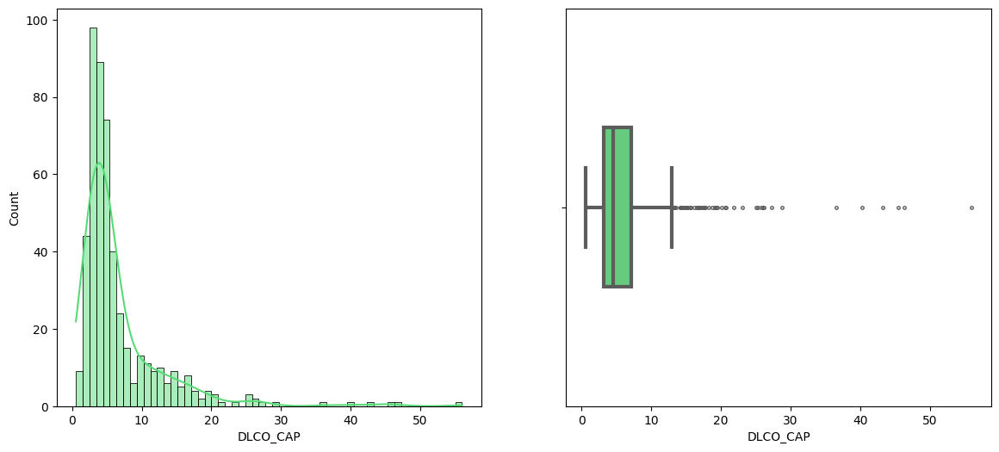

In [6]:
categorical_data = ['Subject ID',
'Baseline FVC Week',
'Followup FVC Week',
'Primary Diagnosis',
'Sex',
'Smoking History',
]
for idx, col in enumerate([i for i in Clinical_demographic_data.columns if i not in categorical_data ]):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (14, 6))
    sns.histplot(Clinical_demographic_data, x = Clinical_demographic_data[col], kde = True,
                 color = sns.color_palette("hls", len([i for i in Clinical_demographic_data.columns if i != 'sex1']))[idx], ax = ax1)
    sns.boxplot(x = Clinical_demographic_data[col], width = 0.4, linewidth = 3, fliersize = 2.5,
                color = sns.color_palette("hls", len([i for i in Clinical_demographic_data.columns if i != 'sex1']))[idx], ax = ax2)
    # fig.suptitle(f"Histogram and Boxplot of {col}", size = 20, y = 1.02)
    plt.show()

In [7]:

#one hot encoding
encoder = OneHotEncoder(sparse_output=False, drop=None)
encoded = encoder.fit_transform(Clinical_demographic_data[['Primary Diagnosis', 'Sex', 'Smoking History']]).astype(int)

# Convert back to DataFrame with column names
encoded_df = pd.DataFrame(encoded, columns=encoder.get_feature_names_out(['Primary Diagnosis', 'Sex', 'Smoking History']))
Clinical_demographic_data_encoded = pd.concat([Clinical_demographic_data.drop(['Primary Diagnosis', 'Sex', 'Smoking History'], axis=1), encoded_df], axis=1)
Clinical_demographic_data_encoded



#---------------------------------------------------------------------

# # Load data
# Clinical_demographic_data = pd.read_csv("/home/pansurya/OSIC_thesis/CSV_ Files/Clinical_demographic_data.csv")

# # Dummy encoding (drop first category for each variable)
# encoder = OneHotEncoder(sparse_output=False, drop="first")  # <-- change here

# # Fit and transform selected categorical columns
# categorical_cols = ['Primary Diagnosis', 'Sex', 'Smoking History']
# encoded = encoder.fit_transform(Clinical_demographic_data[categorical_cols]).astype(int)

# # Convert back to DataFrame with proper column names
# encoded_df = pd.DataFrame(
#     encoded,
#     columns=encoder.get_feature_names_out(categorical_cols),
#     index=Clinical_demographic_data.index
# )

# # Concatenate with the rest of the dataset
# Clinical_demographic_data_encoded = pd.concat(
#     [Clinical_demographic_data.drop(categorical_cols, axis=1), encoded_df],
#     axis=1
# )

# print(Clinical_demographic_data_encoded.columns)


,Subject ID,Baseline FVC Volume L,Baseline FVC Week,Followup FVC Volume L,Followup FVC Week,Age,FEV1 Volume L,DLCO_CAP,Primary Diagnosis_CHP,Primary Diagnosis_CTD-ILD,...,Primary Diagnosis_Occupational-related ILD,Primary Diagnosis_Sarcoidosis,Primary Diagnosis_Smoking Related ILD (DIP / RB / RB-ILD),Primary Diagnosis_UILD,Sex_Female,Sex_Male,Smoking History_Active Smoker,Smoking History_Ex Smoker,Smoking History_Never Smoker,Smoking History_No Knowledge
0,100922,1.49,0,1.73,53.0,77.0,1.16,8.24,0,1,...,0,0,0,0,1,0,0,0,1,0
1,100992,2.18,0,2.08,55.0,68.0,1.75,13.31,0,0,...,0,0,0,1,1,0,0,0,1,0
2,102083,1.27,0,1.15,53.0,48.0,1.10,NaN,0,0,...,0,0,0,1,1,0,0,0,1,0
3,111522,2.88,0,2.83,48.0,67.0,2.41,10.49,0,0,...,0,0,0,0,0,1,0,1,0,0
4,115616,3.11,0,2.93,53.0,75.0,2.41,17.06,0,1,...,0,0,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
549,1006455,3.15,0,3.11,52.0,62.0,2.15,NaN,0,1,...,0,0,0,0,1,0,0,0,1,0
550,1006459,2.75,0,2.14,52.0,66.0,1.82,NaN,0,0,...,0,0,0,0,0,1,0,0,1,0
551,1006781,2.93,0,3.06,52.0,54.0,2.22,NaN,0,0,...,0,0,0,0,0,1,0,0,1,0
552,1006982,4.21,0,4.19,52.0,74.0,2.74,21.77,0,0,...,0,0,0,0,0,1,0,0,1,0


In [8]:
# #lung features data
# Lung_features_data = pd.read_csv("/home/pansurya/OSIC_thesis/radiomics_files/lung_features%.csv")
# Lung_features_data.isna().sum()

In [9]:
Clinical_demographic_data_encoded["Subject ID"] = Clinical_demographic_data_encoded["Subject ID"].astype(str)
RadiomicsFeaturesresults_main["PatientID"] = RadiomicsFeaturesresults_main["PatientID"].astype(str)
# RadiomicsFeaturesresults_main["Subject ID"] = RadiomicsFeaturesresults_main["Subject ID"].astype(str)

# final_df["Followup FVC Volume L"] = final_df["Followup FVC Volume L"].astype(float)
# filtered_df_csv["FVC Volume L"] = filtered_df_csv["FVC Volume L"].astype(float)
# Now merge
merged_radiomic_clinical = pd.merge(
    RadiomicsFeaturesresults_main,
    Clinical_demographic_data_encoded,
    how="inner",
    left_on=["PatientID"],
    right_on=["Subject ID"]
)
merged_radiomic_clinical.drop(columns=["Subject ID"], inplace=True)
merged_radiomic_clinical
print("Merged shape:", merged_radiomic_clinical.shape)
print(list(merged_radiomic_clinical.columns))


# # Ensure all ID columns are strings
# Clinical_demographic_data_encoded["Subject ID"] = Clinical_demographic_data_encoded["Subject ID"].astype(str)
# RadiomicsFeaturesresults_main["PatientID"] = RadiomicsFeaturesresults_main["PatientID"].astype(str)
# Lung_features_data["patient_id"] = Lung_features_data["patient_id"].astype(str)

# # -----------------------------
# # Step 1: Merge Radiomics + Clinical
# # -----------------------------
# merged_radiomic_clinical = pd.merge(
#     RadiomicsFeaturesresults_main,
#     Clinical_demographic_data_encoded,
#     how="inner",
#     left_on="PatientID",
#     right_on="Subject ID"
# )

# # Drop duplicate ID column
# merged_radiomic_clinical.drop(columns=["Subject ID"], inplace=True)

# # -----------------------------
# # Step 2: Merge the Lung Features
# # -----------------------------
# merged_radiomic_clinical1 = pd.merge(
#     merged_radiomic_clinical,
#     Lung_features_data,
#     how="inner",
#     left_on="PatientID",
#     right_on="patient_id"
# )

# # Drop duplicate ID column from lung features
# merged_radiomic_clinical1.drop(columns=["patient_id"], inplace=True)

# # -----------------------------
# # Final output
# # -----------------------------
# print("Final merged shape:", merged_radiomic_clinical1.shape)
# print("Columns:", list(merged_radiomic_clinical1.columns))

# merged_radiomic_clinical1.head()



Merged shape: (554, 2662)
['PatientID', 'original_shape_Elongation_right_lung', 'original_shape_Flatness_right_lung', 'original_shape_LeastAxisLength_right_lung', 'original_shape_MajorAxisLength_right_lung', 'original_shape_Maximum2DDiameterColumn_right_lung', 'original_shape_Maximum2DDiameterRow_right_lung', 'original_shape_Maximum2DDiameterSlice_right_lung', 'original_shape_Maximum3DDiameter_right_lung', 'original_shape_MeshVolume_right_lung', 'original_shape_MinorAxisLength_right_lung', 'original_shape_Sphericity_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_shape_SurfaceVolumeRatio_right_lung', 'original_shape_VoxelVolume_right_lung', 'original_firstorder_10Percentile_right_lung', 'original_firstorder_90Percentile_right_lung', 'original_firstorder_Energy_right_lung', 'original_firstorder_Entropy_right_lung', 'original_firstorder_InterquartileRange_right_lung', 'original_firstorder_Kurtosis_right_lung', 'original_firstorder_Maximum_right_lung', 'original_firstorder

In [10]:
merged_radiomic_clinical.to_csv("/home/pansurya/OSIC_thesis/CSV_ Files/Training_data.csv", index=False)

In [11]:
# Separate features and target
X = merged_radiomic_clinical.drop(columns=["Followup FVC Volume L", "PatientID"])   # all radiomics features
# X = merged_radiomic_clinical.drop(columns=["Followup FVC Volume L"]) 
y = merged_radiomic_clinical["Followup FVC Volume L"]                  # outcome (follow-up FVC)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=321)
# Save splits
joblib.dump((X_train, X_test, y_train, y_test), "/home/pansurya/OSIC_thesis/radiomics_files/data_splits_clinical_without_harmonization.pkl")

X_train


,original_shape_Elongation_right_lung,original_shape_Flatness_right_lung,original_shape_LeastAxisLength_right_lung,original_shape_MajorAxisLength_right_lung,original_shape_Maximum2DDiameterColumn_right_lung,original_shape_Maximum2DDiameterRow_right_lung,original_shape_Maximum2DDiameterSlice_right_lung,original_shape_Maximum3DDiameter_right_lung,original_shape_MeshVolume_right_lung,original_shape_MinorAxisLength_right_lung,...,Primary Diagnosis_Occupational-related ILD,Primary Diagnosis_Sarcoidosis,Primary Diagnosis_Smoking Related ILD (DIP / RB / RB-ILD),Primary Diagnosis_UILD,Sex_Female,Sex_Male,Smoking History_Active Smoker,Smoking History_Ex Smoker,Smoking History_Never Smoker,Smoking History_No Knowledge
35,0.915799,0.649460,118.336553,182.207599,214.448129,220.000000,199.624648,242.761200,1.911959e+06,166.865584,...,0,0,0,1,1,0,0,0,1,0
71,0.836066,0.451543,95.141557,210.703051,272.183761,275.588461,187.010695,278.783070,1.915304e+06,176.161750,...,0,1,0,0,0,1,0,0,1,0
365,0.339358,0.135877,66.390412,488.606602,588.340038,179.627392,622.776043,623.718687,2.944462e+06,165.812678,...,0,0,0,0,0,1,0,1,0,0
69,0.944440,0.604283,113.119646,187.196416,251.509443,231.423854,187.109594,252.978260,2.161386e+06,176.795697,...,0,0,0,0,0,1,0,1,0,0
352,0.756468,0.685926,166.880658,243.292388,299.387708,266.242371,250.639183,349.584039,4.289176e+06,184.043024,...,0,0,0,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
410,0.870300,0.803142,147.847964,184.086900,238.304427,197.433533,208.741467,239.409691,2.587442e+06,160.210867,...,0,0,0,1,0,1,0,1,0,0
168,0.552656,0.417340,107.275533,257.045952,327.757532,311.777164,160.078106,333.390162,2.133628e+06,142.057995,...,0,0,0,0,1,0,0,0,1,0
401,0.766941,0.534782,129.867777,242.842653,291.247318,211.872603,302.238317,304.916382,3.262359e+06,186.246084,...,0,0,0,0,0,1,0,1,0,0
124,0.859386,0.565791,127.557280,225.449408,269.156089,223.181540,284.787640,289.836161,3.012221e+06,193.748163,...,0,0,0,0,0,1,0,0,1,0


In [12]:
X_train['DLCO_CAP']

35     6.260000
71     4.030000
365    4.777596
69     2.790000
352         NaN
         ...   
410    3.920000
168    7.500000
401         NaN
124         NaN
538    5.828868
Name: DLCO_CAP, Length: 443, dtype: float64

In [13]:

# # normality test on s3
X_train_shapiro = X_train.copy()
stat, p = shapiro(X_train_shapiro['DLCO_CAP'].dropna())
print('Statistics=%.3f, p=%.3f' % (stat, p))
# interpret
alpha = 0.05
if p > alpha:
    print('Sample looks normally distributed (fail to reject H0)')
else:
    print('Sample does not look normally distributed (reject H0)')


Statistics=0.640, p=0.000
Sample does not look normally distributed (reject H0)


In [14]:
# # normality test on log of s3
X_train_shapiro_log = X_train.copy()
stat, p = shapiro(np.log(X_train_shapiro_log['DLCO_CAP'].dropna())) ### REPLACE WITH YOUR CODE ###
print('Statistics=%.3f, p=%.3f' % (stat, p))
# interpret
alpha = 0.05
if p > alpha:
    print('Sample looks normally distributed (fail to reject H0)')
else:
    print('Sample does not look normally distributed (reject H0)')

Statistics=0.960, p=0.000
Sample does not look normally distributed (reject H0)


In [15]:
# # normality test on log of s3 'FEV1 Volume L', 'Baseline FVC Volume L', Followup FVC Volume L
X_train_shapiro_sqrt = X_train.copy()
stat, p = shapiro(np.sqrt(X_train_shapiro_sqrt['Baseline FVC Volume L'].dropna())) ### REPLACE WITH YOUR CODE ###
print('Statistics=%.3f, p=%.3f' % (stat, p))
# interpret
alpha = 0.05
if p > alpha:
    print('Sample looks normally distributed (fail to reject H0)')
else:
    print('Sample does not look normally distributed (reject H0)')

Statistics=0.996, p=0.234
Sample looks normally distributed (fail to reject H0)


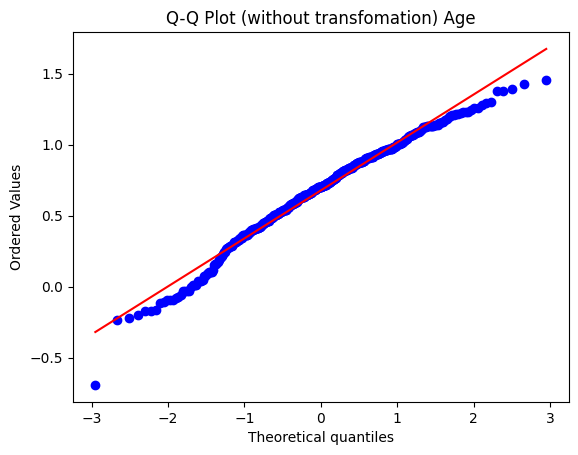

In [16]:
from scipy.stats import probplot
def plot_qq(series, title):
    """Plot Q-Q plot for visual inspection."""
    probplot(series, dist="norm", plot=plt)
    plt.title(title)
    plt.show()
col = X_train['FEV1 Volume L']
plot_qq(np.log(col.dropna()), "Q-Q Plot (without transfomation) Age")

Original: stat=0.6483751346, p=0.0000000000 → Not Normal
Log: stat=0.9624860422, p=0.0000000006 → Not Normal
Sqrt: stat=0.8382906998, p=0.0000000000 → Not Normal
Box-Cox (λ=-0.314): stat=0.9855958945, p=0.0000771685 → Not Normal
Yeo-Johnson: stat=0.9891184220, p=0.0009355364 → Not Normal


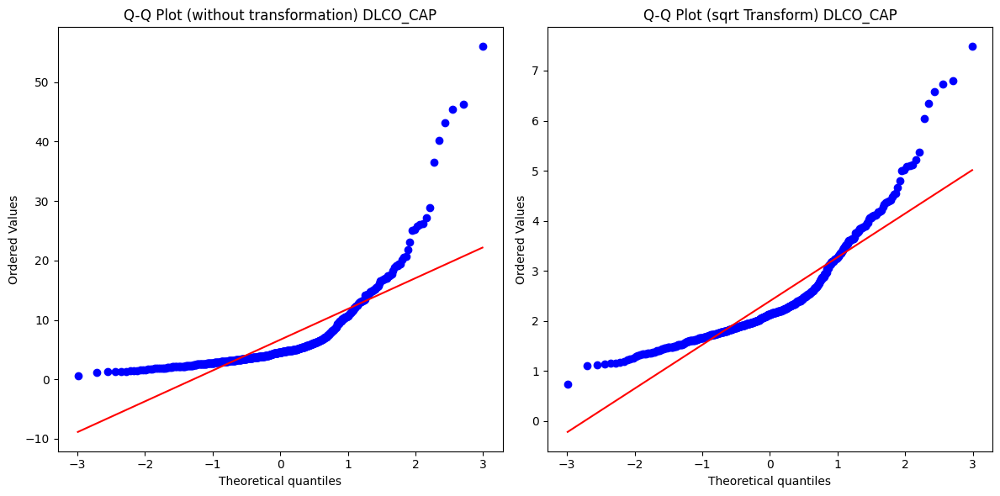

In [36]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import shapiro, boxcox, probplot
from sklearn.preprocessing import PowerTransformer

def check_normality(series, alpha=0.05):
    """Run Shapiro-Wilk test and return p-value."""
    stat, p = shapiro(series)
    return stat, p, "Normal" if p > alpha else "Not Normal"

def try_transformations(series):
    series = series.dropna().values
    
    results = {}
    
    # Original
    stat, p, verdict = check_normality(series)
    results["Original"] = (stat, p, verdict)
    
    # Log (only if all values > 0)
    if np.all(series > 0):
        stat, p, verdict = check_normality(np.log(series))
        results["Log"] = (stat, p, verdict)
    
    # Square root (only if all values >= 0)
    if np.all(series >= 0):
        stat, p, verdict = check_normality(np.sqrt(series))
        results["Sqrt"] = (stat, p, verdict)
    
    # Box-Cox (only if all values > 0)
    if np.all(series > 0):
        boxcox_series, lam = boxcox(series)
        stat, p, verdict = check_normality(boxcox_series)
        results["Box-Cox (λ=%.3f)" % lam] = (stat, p, verdict)
    
    # Yeo-Johnson (works with negatives too)
    pt = PowerTransformer(method="yeo-johnson")
    yeo_series = pt.fit_transform(series.reshape(-1,1)).flatten()
    stat, p, verdict = check_normality(yeo_series)
    results["Yeo-Johnson"] = (stat, p, verdict)
    
    return results

def plot_qq(series, title, ax):
    """Plot Q-Q plot for visual inspection on a given axis."""
    probplot(series, dist="norm", plot=ax)
    ax.set_title(title)

# Example usage on your column
X_train_normality = merged_radiomic_clinical.copy()
col = X_train_normality['DLCO_CAP']

results = try_transformations(col)

# Print results
for method, (stat, p, verdict) in results.items():
    print(f"{method}: stat={stat:.10f}, p={p:.10f} → {verdict}")

# Example: plot Q-Q plot for the best candidate
# Data
col1 = merged_radiomic_clinical['DLCO_CAP'].dropna()

# Create subplots: 1 row, 2 columns
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Plot both Q-Q plots in the same figure
plot_qq(col1, "Q-Q Plot (without transformation) DLCO_CAP", axes[0])
plot_qq(np.sqrt(col.dropna()), "Q-Q Plot (sqrt Transform) DLCO_CAP", axes[1])

plt.tight_layout()
plt.show()


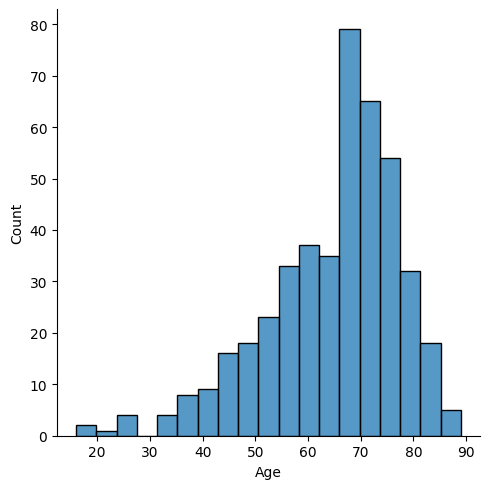

In [18]:
sns.displot(X_train['Age'])
plt.show()

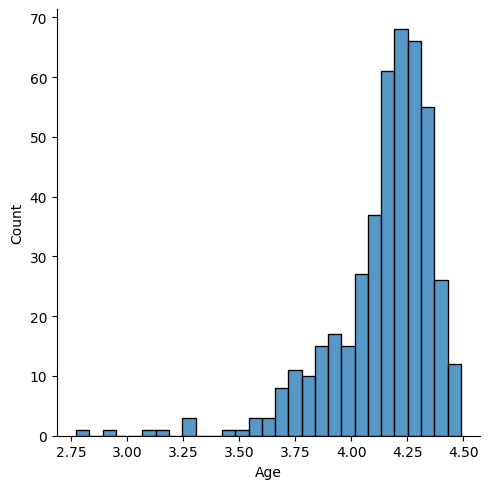

In [19]:
X_train_bar_log = X_train.copy()
X_train_bar_log["Age"] = np.log(X_train_bar_log["Age"])
sns.displot(X_train_bar_log["Age"])
plt.show()

In [20]:
# import numpy as np
# import pandas as pd
# from scipy.stats import boxcox
# from scipy.stats import shapiro

# # Example: your feature column
# x = X_train['DLCO_CAP'].values
# print(len(x))
# # Box–Cox requires strictly positive values
# x = x[x > 0]
# print(len(x))
# # Apply Box–Cox
# x_transformed, lambda_val = boxcox(x)

# print("Lambda used:", lambda_val)

# # Test normality again
# stat, p = shapiro(x_transformed)
# print('Statistics=%.3f, p=%.3f' % (stat, p))
# if p > 0.05:
#     print("Looks normally distributed")
# else:
#     print("Still not normal")


In [21]:
# linear regression dropping NANs
clinical_data = ['Baseline FVC Volume L', 'Age', 'FEV1 Volume L', 'DLCO_CAP',
       'Primary Diagnosis_CTD-ILD',
       'Primary Diagnosis_Emphysema', 'Primary Diagnosis_Exposure-related',
       'Primary Diagnosis_Fibrotic HP (FHP)', 'Primary Diagnosis_INSIP',
       'Primary Diagnosis_IPF', 'Primary Diagnosis_Idiopathic OP',
       'Primary Diagnosis_Idiopathic pleuroparenchymal fibroelastosis (IPPFE)',
       'Primary Diagnosis_Miscellaneous', 
       'Primary Diagnosis_No information',
       'Primary Diagnosis_Occupational-related ILD',
       'Primary Diagnosis_Sarcoidosis',
       'Primary Diagnosis_Smoking Related ILD (DIP / RB / RB-ILD)',
       'Primary Diagnosis_UILD', 'Sex_Male',
       'Smoking History_Ex Smoker',
       'Smoking History_Never Smoker', 'Smoking History_No Knowledge']
X_train_clini = X_train[clinical_data]
X_test_clini = X_test[clinical_data]
# Get NAN indices
nonnan_train_indices = X_train_clini.index[~X_train_clini.isna().max(axis=1)]
nonnan_test_indices = X_test_clini.index[~X_test_clini.isna().max(axis=1)]
print(nonnan_train_indices)
# Fit an instance of `LinearRegression`
reg = LinearRegression().fit(X_train_clini.loc[nonnan_train_indices], y_train.loc[nonnan_train_indices])
# Generate predictions
pred = reg.predict(X_test_clini.loc[nonnan_test_indices])
# Calculate the root mean squared error
root_mean_squared_error(y_test.loc[nonnan_test_indices],pred)

Index([ 35,  71, 365,  69, 142, 155, 145, 392, 463,  65,
       ...
       525, 189, 116, 553, 213, 328, 357, 410, 168, 538],
      dtype='int64', length=390)


0.2953293744362772

In [22]:
# linear regression with mean fill

# Get NAN indices
nonnan_train_indices = X_train_clini.index[~X_train_clini.isna().max(axis=1)]
nonnan_test_indices = X_test_clini.index[~X_test_clini.isna().max(axis=1)]
print(nonnan_train_indices)
# Initialize the simple imputer
imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
# Fit the simple imputer using the training data
imp_mean.fit(X_train_clini)

# Actually mean fill the training data
X_train_mean_filled = imp_mean.transform(X_train_clini)
X_test_mean_filled = imp_mean.transform(X_test_clini)
print(len(X_train_mean_filled))
# Fit an instance of `LinearRegression`
reg = LinearRegression().fit(X_train_mean_filled, y_train)
# Generate predictions
pred = reg.predict(X_test_mean_filled)
# Calculate the root mean squared error
root_mean_squared_error(y_test,pred)

Index([ 35,  71, 365,  69, 142, 155, 145, 392, 463,  65,
       ...
       525, 189, 116, 553, 213, 328, 357, 410, 168, 538],
      dtype='int64', length=390)
443


0.329204063824785

In [23]:
# linear regression with meadian fill

# Get NAN indices
nonnan_train_indices = X_train_clini.index[~X_train_clini.isna().max(axis=1)]
nonnan_test_indices = X_test_clini.index[~X_test_clini.isna().max(axis=1)]
print(nonnan_train_indices)
# Initialize the simple imputer
imp_median = SimpleImputer(missing_values=np.nan, strategy='median')
# Fit the simple imputer using the training data
imp_median.fit(X_train_clini)

# Actually mean fill the training data
X_train_mean_filled = imp_median.transform(X_train_clini)
X_test_mean_filled = imp_median.transform(X_test_clini)
print(len(X_train_mean_filled))
# Fit an instance of `LinearRegression`
reg = LinearRegression().fit(X_train_mean_filled, y_train)
# Generate predictions
pred = reg.predict(X_test_mean_filled)
# Calculate the root mean squared error
root_mean_squared_error(y_test,pred)

Index([ 35,  71, 365,  69, 142, 155, 145, 392, 463,  65,
       ...
       525, 189, 116, 553, 213, 328, 357, 410, 168, 538],
      dtype='int64', length=390)
443


0.3291631059066602

In [24]:
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Define which columns get which imputation
mean_cols = ['FEV1 Volume L']
median_cols = ['DLCO_CAP']

# --- 1. Copy train/test ---
X_train_filled = X_train_clini.copy()
X_test_filled  = X_test_clini.copy()

# --- 2. Apply mean imputation only to FEV1 L ---
mean_imputer = SimpleImputer(strategy="mean")
X_train_filled[mean_cols] = mean_imputer.fit_transform(X_train_clini[mean_cols])
X_test_filled[mean_cols]  = mean_imputer.transform(X_test_clini[mean_cols])

# --- 3. Apply median imputation only to DLCO_CAP ---
median_imputer = SimpleImputer(strategy="median")
X_train_filled[median_cols] = median_imputer.fit_transform(X_train_clini[median_cols])
X_test_filled[median_cols]  = median_imputer.transform(X_test_clini[median_cols])

# Fit linear regression
reg = LinearRegression()
reg.fit(X_train_filled, y_train)

# Predict
pred = reg.predict(X_test_filled)

# RMSE
rmse = root_mean_squared_error(y_test,pred)
print("Root Mean Squared Error:", rmse)


Root Mean Squared Error: 0.32913765438364656


In [25]:
#influence age
import numpy as np
import pandas as pd
from scipy.stats import boxcox
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# --- 1. Copy train/test ---
X_train_clini_boxcox = X_train_clini.copy()
X_test_clini_boxcox = X_test_clini.copy()

# Columns to transform
# cols_to_transform = ['DLCO_CAP', 'Age']
cols_to_transform = ['DLCO_CAP', 'Age']
# Apply Box-Cox transform (requires strictly positive values)
for col in cols_to_transform:
    # Drop NaNs temporarily for fitting
    non_nan_train = X_train_clini_boxcox[col].dropna()
    non_nan_test = X_test_clini_boxcox[col].dropna()
    
    # Box-Cox transform on training column
    transformed_train, lam = boxcox(non_nan_train)
    # Replace values back into DataFrame
    X_train_clini_boxcox.loc[non_nan_train.index, col] = transformed_train
    
    # Apply same lambda to test column
    X_test_clini_boxcox.loc[non_nan_test.index, col] = boxcox(non_nan_test, lmbda=lam)

    print(f"Applied Box-Cox to {col} with λ={lam:.3f}")

# Initialize the simple imputer (median fill)
imp_median = SimpleImputer(missing_values=np.nan, strategy='median')
imp_median.fit(X_train_clini_boxcox)

# Transform train and test
X_train_median_filled = imp_median.transform(X_train_clini_boxcox)
X_test_median_filled = imp_median.transform(X_test_clini_boxcox)

# Fit linear regression
reg = LinearRegression().fit(X_train_median_filled, y_train)

# Predictions
pred = reg.predict(X_test_median_filled)

# RMSE
rmse = root_mean_squared_error(y_test, pred)
print("RMSE:", rmse)


Applied Box-Cox to DLCO_CAP with λ=-0.305
Applied Box-Cox to Age with λ=2.405
RMSE: 0.3317605096989629


In [26]:
#influence age
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# --- 1. Copy train/test ---
X_train_clini_log = X_train_clini.copy()
X_test_clini_log  = X_test_clini.copy()

# Columns to transform
cols_to_transform = ['Age']

# Example: sqrt transform
for col in cols_to_transform:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

print(X_train_clini_log.shape)
# Initialize the simple imputer (median fill)
imp_median = SimpleImputer(missing_values=np.nan, strategy='median')
imp_median.fit(X_train_clini_log)

# Transform train and test
X_train_median_filled = imp_median.transform(X_train_clini_log)
X_test_median_filled = imp_median.transform(X_test_clini_log)

# Fit linear regression
reg = LinearRegression().fit(X_train_median_filled, y_train)

# Predictions
pred = reg.predict(X_test_median_filled)

# RMSE
rmse = root_mean_squared_error(y_test, pred)
print("RMSE:", rmse)


(443, 22)
RMSE: 0.32739234042042115


In [27]:
#influence age
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# --- 1. Copy train/test ---
X_train_clini_sqrt = X_train_clini.copy()
X_test_clini_sqrt  = X_test_clini.copy()

# Columns to transform
# cols_to_transform = ['FEV1 Volume L', 'Baseline FVC Volume L'] ['DLCO_CAP', 'Age']
cols_to_transform = ['DLCO_CAP', 'Age']

# Example: sqrt transform
for col in cols_to_transform:
    X_train_clini_sqrt[col] = np.sqrt(X_train_clini_sqrt[col])
    X_test_clini_sqrt[col] = np.sqrt(X_test_clini_sqrt[col])

print(X_train_clini_sqrt.shape)
# Initialize the simple imputer (median fill)
imp_median = SimpleImputer(missing_values=np.nan, strategy='median')
imp_median.fit(X_train_clini_sqrt)

# Transform train and test
X_train_median_filled = imp_median.transform(X_train_clini_sqrt)
X_test_median_filled = imp_median.transform(X_test_clini_sqrt)

# Fit linear regression
reg = LinearRegression().fit(X_train_median_filled, y_train)

# Predictions
pred = reg.predict(X_test_median_filled)

# RMSE
rmse = root_mean_squared_error(y_test, pred)
print("RMSE:", rmse)


(443, 22)
RMSE: 0.32833409113797146


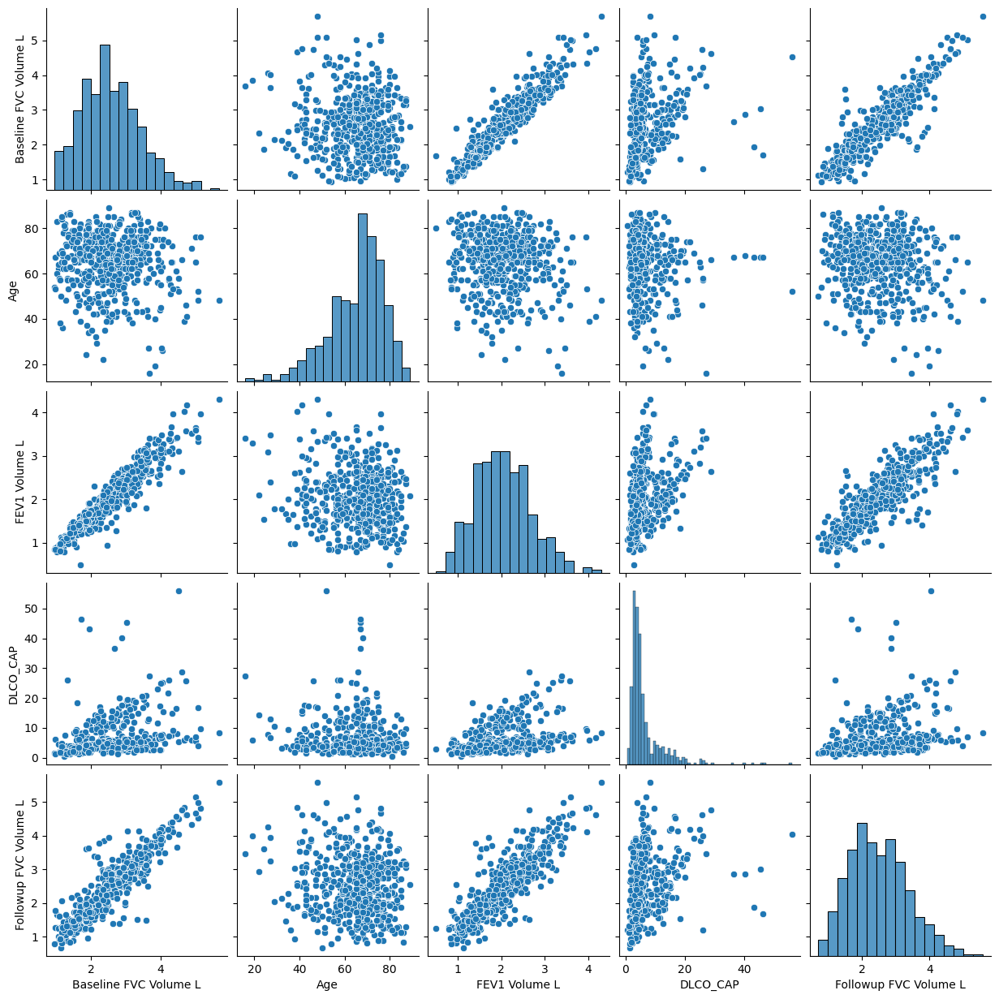

In [28]:
# --- 1. Copy train/test ---
Clinical_demographic_data_encoded_log = Clinical_demographic_data_encoded.copy()
X_test_clini_log  = X_test_clini.copy()

# # Columns to transform
# cols_to_transform = ['DLCO_CAP', 'Age']

# # Example: sqrt transform
# for col in cols_to_transform:
#     Clinical_demographic_data_encoded_log[col] = np.log(Clinical_demographic_data_encoded_log[col])
#     X_test_clini_log[col] = np.log(X_test_clini_log[col])
clinical_data_pair = ['Baseline FVC Volume L', 
        'Age', 'FEV1 Volume L', 'DLCO_CAP', 'Followup FVC Volume L']
sns.pairplot(Clinical_demographic_data_encoded_log[clinical_data_pair])
plt.show()

NameError: name 'h' is not defined

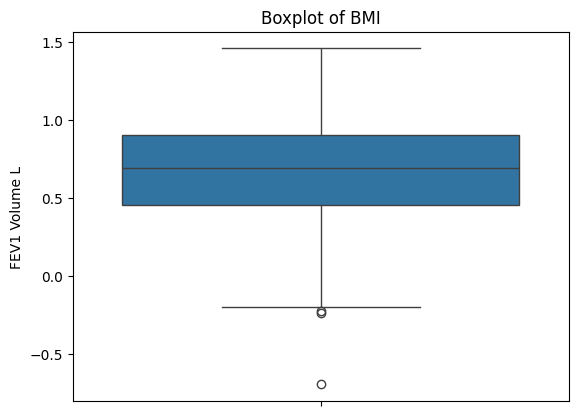

In [29]:
import sklearn
from sklearn.datasets import load_diabetes
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


sns.boxplot(np.log(merged_radiomic_clinical['FEV1 Volume L']))
plt.title('Boxplot of BMI')
plt.show(h)

In [ ]:
def removal_box_plot(df, column, threshold):
    removed_outliers = df[df[column] <= threshold]

threshold_value = 20

no_outliers = X_train_clini.index[X_train_clini["Age"] >= 30]
print(no_outliers)

Index([ 68, 231,  63, 436,  60,  15, 131, 478, 473, 208,
       ...
       330, 214, 466, 121,  20,  71, 106, 270, 435, 102],
      dtype='int64', length=453)


In [ ]:
# linear regression with median fill, using the log of 's3', and removal of outlier from 's2':

# Outlier removal
X_train_nonoutlier_idx = X_train_clini.index[X_train_clini['FEV1 Volume L'] < X_train_clini['FEV1 Volume L'].quantile(0.999)]
X_train_clini = X_train_clini.loc[X_train_nonoutlier_idx]
y_train = y_train.loc[X_train_nonoutlier_idx]

# Get NAN indices
nonnan_train_indices = X_train_clini.index[~X_train_clini.isna().max(axis=1)]
nonnan_test_indices = X_test_clini.index[~X_test_clini.isna().max(axis=1)]

# Initialize the simple imputer
imp_median = SimpleImputer(missing_values=np.nan, strategy='median')
# Fit the simple imputer using the training data
imp_median.fit(X_train_clini)
# Actually median fill the training data
X_train_median_filled = imp_median.transform(X_train_clini)

# Fit an instance of `LinearRegression`
reg = LinearRegression().fit(X_train_median_filled, y_train)
# Generate predictions
pred = reg.predict(X_test_clini.loc[nonnan_test_indices])
# Calculate the root mean squared error
root_mean_squared_error(y_test.loc[nonnan_test_indices],pred)

0.38369501695836183

In [ ]:
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


# --- Step 1: Compute Z-scores for Age column ---
z_scores = (X_train_clini['FEV1 Volume L']  - X_train_clini['FEV1 Volume L'] .mean()) / X_train_clini['FEV1 Volume L'] .std()

# --- Step 2: Keep only rows where |Z| <= 3 ---
X_train_clini = X_train_clini.loc[z_scores.abs() <= 3]
y_train = y_train.loc[X_train_clini.index]
print(X_train_clini.shape)
# Get NAN indices
nonnan_train_indices = X_train_clini.index[~X_train_clini.isna().max(axis=1)]
nonnan_test_indices = X_test_clini.index[~X_test_clini.isna().max(axis=1)]

# --- Step 3: Apply median imputation (mean fill) ---
imp_median = SimpleImputer(missing_values=np.nan, strategy='median')
imp_median.fit(X_train_clini)

X_train_filled = imp_median.transform(X_train_clini)


# --- Step 4: Fit regression model ---
reg = LinearRegression().fit(X_train_filled, y_train)

# --- Step 5: Predict on test set ---
pred = reg.predict(X_test_clini.loc[nonnan_test_indices])

# --- Step 6: Evaluate RMSE ---
rmse = root_mean_squared_error(y_test.loc[nonnan_test_indices],pred)
print("RMSE:", rmse)

(451, 22)
RMSE: 0.3836927432644765


In [ ]:
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# --- Step 1: Compute IQR for Baseline FVC Volume L column ---
Q1 = X_train_clini['DLCO_CAP'] .quantile(0.25)
Q3 = X_train_clini['DLCO_CAP'] .quantile(0.75)
IQR = Q3 - Q1

# --- Step 2: Keep only rows within bounds (remove outliers) ---
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
print(lower_bound)
print(upper_bound)
X_train_clini = X_train_clini.loc[
    (X_train_clini['DLCO_CAP']  >= lower_bound) &
    (X_train_clini['DLCO_CAP']  <= upper_bound)
]
print(X_train_clini)
y_train = y_train.loc[X_train_clini.index]

# Get NAN indices
nonnan_train_indices = X_train_clini.index[~X_train_clini.isna().max(axis=1)]
nonnan_test_indices = X_test_clini.index[~X_test_clini.isna().max(axis=1)]

# --- Step 3: Apply median imputation ---
imp_median = SimpleImputer(missing_values=np.nan, strategy='median')
imp_median.fit(X_train_clini)

X_train_filled = imp_median.transform(X_train_clini)

# --- Step 4: Fit regression model ---
reg = LinearRegression().fit(X_train_filled, y_train)

# --- Step 5: Predict on test set ---
pred = reg.predict(X_test_clini.loc[nonnan_test_indices])

# --- Step 6: Evaluate RMSE ---
rmse = root_mean_squared_error(y_test.loc[nonnan_test_indices], pred)
print("RMSE:", rmse)


-2.1415289999999993
12.056223
     Baseline FVC Volume L   Age  FEV1 Volume L   DLCO_CAP  \
231                   1.94  69.0           1.58   4.864644   
63                    2.26  71.0           1.85   3.378132   
436                   2.91  62.0           2.29   4.840000   
15                    1.94  70.0           1.65  10.900000   
478                   2.47  65.0           2.03   3.348000   
..                     ...   ...            ...        ...   
71                    2.22  66.0           1.97   3.632580   
106                   1.81  67.0           1.49   3.682800   
270                   2.31  73.0           1.69   6.660000   
435                   1.95  74.0           1.72   5.730000   
102                   2.58  51.0           1.46   2.758752   

     Primary Diagnosis_CTD-ILD  Primary Diagnosis_Emphysema  \
231                          1                            0   
63                           0                            0   
436                          0      

In [ ]:
print(Clinical_demographic_data_encoded.columns.tolist())


['Subject ID', 'Baseline FVC Volume L', 'Baseline FVC Week', 'Followup FVC Volume L', 'Followup FVC Week', 'Age', 'FEV1 Volume L', 'DLCO_CAP', 'Primary Diagnosis_CHP', 'Primary Diagnosis_CTD-ILD', 'Primary Diagnosis_Emphysema', 'Primary Diagnosis_Exposure-related', 'Primary Diagnosis_Fibrotic HP (FHP)', 'Primary Diagnosis_INSIP', 'Primary Diagnosis_IPF', 'Primary Diagnosis_Idiopathic OP', 'Primary Diagnosis_Idiopathic pleuroparenchymal fibroelastosis (IPPFE)', 'Primary Diagnosis_Miscellaneous', 'Primary Diagnosis_NSIP', 'Primary Diagnosis_No information', 'Primary Diagnosis_Occupational-related ILD', 'Primary Diagnosis_Sarcoidosis', 'Primary Diagnosis_Smoking Related ILD (DIP / RB / RB-ILD)', 'Primary Diagnosis_UILD', 'Sex_Female', 'Sex_Male', 'Smoking History_Active Smoker', 'Smoking History_Ex Smoker', 'Smoking History_Never Smoker', 'Smoking History_No Knowledge']


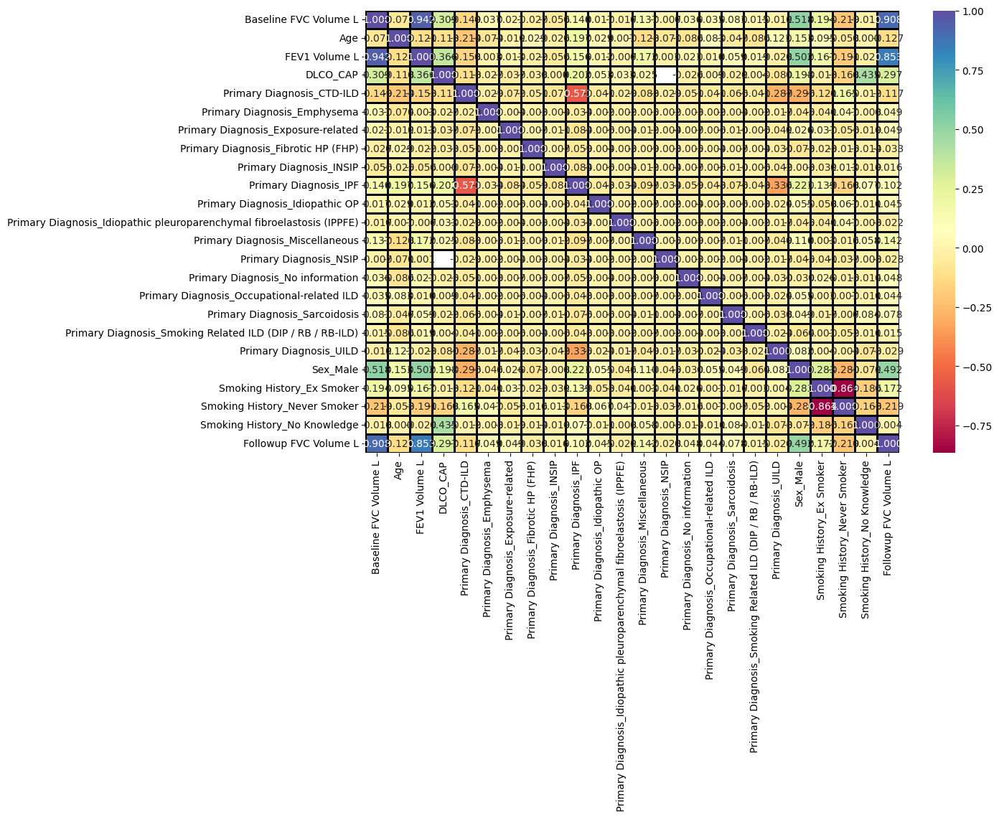

In [ ]:
plt.figure(figsize=(12, 8))

# Combine your list of columns with the extra column
clinical_data_corr = ['Baseline FVC Volume L', 'Age', 'FEV1 Volume L',
       'DLCO_CAP', 'Primary Diagnosis_CTD-ILD',
       'Primary Diagnosis_Emphysema', 'Primary Diagnosis_Exposure-related',
       'Primary Diagnosis_Fibrotic HP (FHP)', 'Primary Diagnosis_INSIP',
       'Primary Diagnosis_IPF', 'Primary Diagnosis_Idiopathic OP',
       'Primary Diagnosis_Idiopathic pleuroparenchymal fibroelastosis (IPPFE)',
       'Primary Diagnosis_Miscellaneous', 'Primary Diagnosis_NSIP',
       'Primary Diagnosis_No information',
       'Primary Diagnosis_Occupational-related ILD',
       'Primary Diagnosis_Sarcoidosis',
       'Primary Diagnosis_Smoking Related ILD (DIP / RB / RB-ILD)',
       'Primary Diagnosis_UILD', 'Sex_Male',
       'Smoking History_Ex Smoker',
       'Smoking History_Never Smoker', 'Smoking History_No Knowledge', 'Followup FVC Volume L']

sns.heatmap(
    Clinical_demographic_data_encoded[clinical_data_corr].corr(),
    annot=True,
    cmap="Spectral",
    linewidths=2,
    linecolor="#000000",
    fmt=".3f"
)

plt.show()


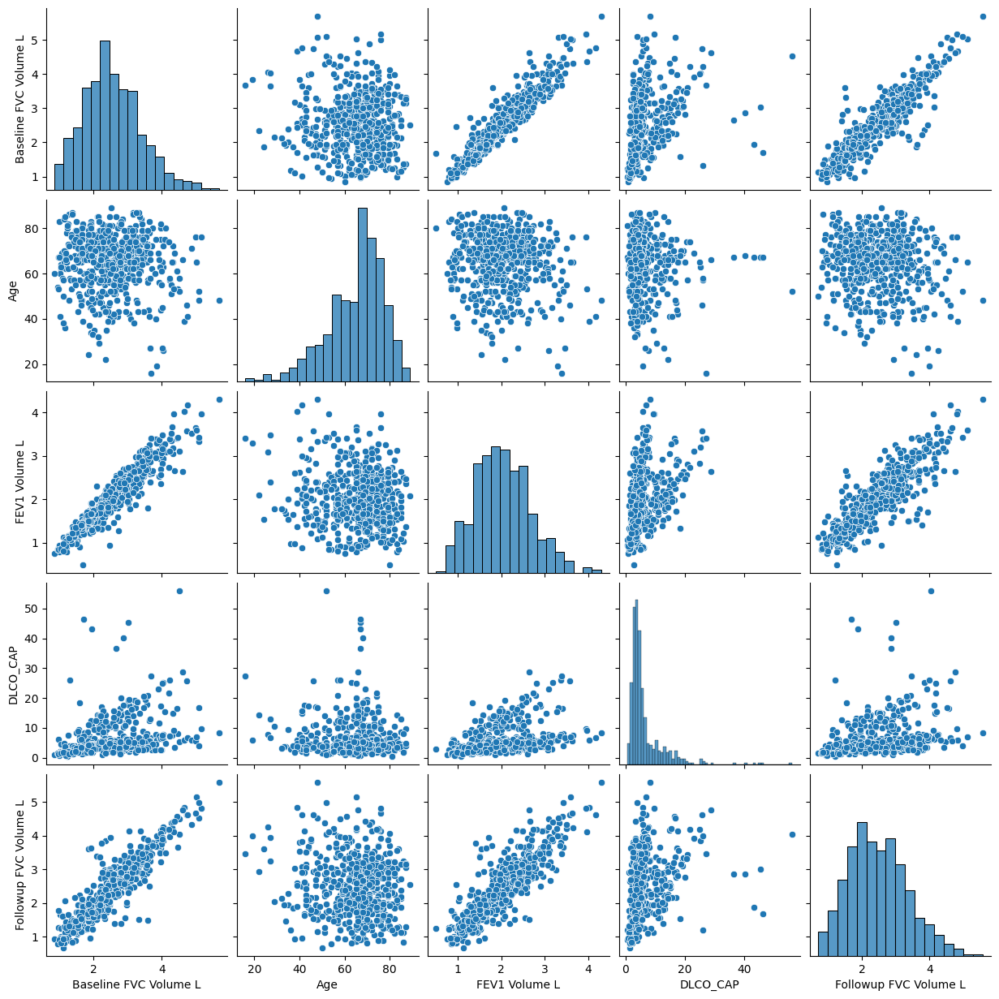

In [ ]:
clinical_data_pair = ['Baseline FVC Volume L', 'Age', 'FEV1 Volume L', 'DLCO_CAP', 'Followup FVC Volume L']
sns.pairplot(Clinical_demographic_data_encoded[clinical_data_pair])
plt.show()

In [ ]:
from sklearn.feature_selection import VarianceThreshold
import pandas as pd

# Initialize selector
vt = VarianceThreshold(threshold=0)  # remove features with 0 variance

# Fit on training data
X_train_vt = vt.fit_transform(X_train)

# Apply the same transformation to test data
X_test_vt = vt.transform(X_test)

# Get the selected feature names (non-zero variance)
selected_columns = X_train.columns[vt.get_support()]

# Get the dropped feature names (zero variance)
dropped_columns = X_train.columns[~vt.get_support()]

# Wrap back into DataFrames
X_train_vt = pd.DataFrame(X_train_vt, columns=selected_columns, index=X_train.index)
X_test_vt  = pd.DataFrame(X_test_vt,  columns=selected_columns, index=X_test.index)


#Drop the clinical data columns
Drop_Clinical_Columns = ['Baseline FVC Volume L',
        'Followup FVC Week', 'Age', 'FEV1 Volume L', 
                           'DLCO_CAP',
       'Primary Diagnosis_CHP', 'Primary Diagnosis_CTD-ILD',
                   'Primary Diagnosis_Emphysema', 
       'Primary Diagnosis_Exposure-related',
       'Primary Diagnosis_Fibrotic HP (FHP)', 'Primary Diagnosis_INSIP',
       'Primary Diagnosis_IPF', 'Primary Diagnosis_Idiopathic OP',
                     'Primary Diagnosis_Idiopathic pleuroparenchymal fibroelastosis (IPPFE)',
       'Primary Diagnosis_Miscellaneous', 'Primary Diagnosis_NSIP',
       'Primary Diagnosis_No information',
       'Primary Diagnosis_Occupational-related ILD',
       'Primary Diagnosis_Sarcoidosis',
        'Primary Diagnosis_Smoking Related ILD (DIP / RB / RB-ILD)',
       'Primary Diagnosis_UILD', 'Sex_Female', 'Sex_Male',
       'Smoking History_Active Smoker', 'Smoking History_Ex Smoker',
       'Smoking History_Never Smoker', 'Smoking History_No Knowledge']

X_train_vt = X_train_vt.drop(columns=Drop_Clinical_Columns) 
X_test_vt = X_test_vt.drop(columns=Drop_Clinical_Columns) 

print("Train shape after VarianceThreshold:", X_train_vt.shape)
print("Test shape after VarianceThreshold:", X_test_vt.shape)

print("\n✅ Features kept (non-zero variance):", list(selected_columns))
print("\n🗑️ Features dropped (zero variance):", list(dropped_columns))
X_train_vt

Train shape after VarianceThreshold: (443, 2632)
Test shape after VarianceThreshold: (111, 2632)

✅ Features kept (non-zero variance): ['original_shape_Elongation_right_lung', 'original_shape_Flatness_right_lung', 'original_shape_LeastAxisLength_right_lung', 'original_shape_MajorAxisLength_right_lung', 'original_shape_Maximum2DDiameterColumn_right_lung', 'original_shape_Maximum2DDiameterRow_right_lung', 'original_shape_Maximum2DDiameterSlice_right_lung', 'original_shape_Maximum3DDiameter_right_lung', 'original_shape_MeshVolume_right_lung', 'original_shape_MinorAxisLength_right_lung', 'original_shape_Sphericity_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_shape_SurfaceVolumeRatio_right_lung', 'original_shape_VoxelVolume_right_lung', 'original_firstorder_10Percentile_right_lung', 'original_firstorder_90Percentile_right_lung', 'original_firstorder_Energy_right_lung', 'original_firstorder_Entropy_right_lung', 'original_firstorder_InterquartileRange_right_lung', 'original

,original_shape_Elongation_right_lung,original_shape_Flatness_right_lung,original_shape_LeastAxisLength_right_lung,original_shape_MajorAxisLength_right_lung,original_shape_Maximum2DDiameterColumn_right_lung,original_shape_Maximum2DDiameterRow_right_lung,original_shape_Maximum2DDiameterSlice_right_lung,original_shape_Maximum3DDiameter_right_lung,original_shape_MeshVolume_right_lung,original_shape_MinorAxisLength_right_lung,...,log-sigma-5-0-mm-3D_gldm_LargeDependenceLowGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_LowGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_SmallDependenceEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_SmallDependenceHighGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_ngtdm_Busyness_left_lung,log-sigma-5-0-mm-3D_ngtdm_Coarseness_left_lung,log-sigma-5-0-mm-3D_ngtdm_Complexity_left_lung,log-sigma-5-0-mm-3D_ngtdm_Contrast_left_lung,log-sigma-5-0-mm-3D_ngtdm_Strength_left_lung
35,0.915799,0.649460,118.336553,182.207599,214.448129,220.000000,199.624648,242.761200,1.911959e+06,166.865584,...,0.514988,0.002298,0.021882,10.848528,0.000054,30.296450,0.000029,228.301830,0.008010,0.023714
71,0.836066,0.451543,95.141557,210.703051,272.183761,275.588461,187.010695,278.783070,1.915304e+06,176.161750,...,0.493216,0.002066,0.020164,11.132252,0.000045,31.921446,0.000022,275.907653,0.006095,0.023873
365,0.339358,0.135877,66.390412,488.606602,588.340038,179.627392,622.776043,623.718687,2.944462e+06,165.812678,...,0.650542,0.003380,0.017321,5.888175,0.000062,57.458570,0.000021,171.426793,0.007651,0.012020
69,0.944440,0.604283,113.119646,187.196416,251.509443,231.423854,187.109594,252.978260,2.161386e+06,176.795697,...,0.735855,0.003153,0.016204,6.663807,0.000047,43.260239,0.000023,216.410717,0.006753,0.018912
352,0.756468,0.685926,166.880658,243.292388,299.387708,266.242371,250.639183,349.584039,4.289176e+06,184.043024,...,0.635999,0.002876,0.013655,5.224177,0.000044,61.905606,0.000015,183.163925,0.005211,0.012093
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
410,0.870300,0.803142,147.847964,184.086900,238.304427,197.433533,208.741467,239.409691,2.587442e+06,160.210867,...,0.741807,0.002526,0.020060,9.561914,0.000052,35.934543,0.000020,289.852164,0.005664,0.026330
168,0.552656,0.417340,107.275533,257.045952,327.757532,311.777164,160.078106,333.390162,2.133628e+06,142.057995,...,0.447450,0.002259,0.019582,10.024488,0.000048,41.033981,0.000019,244.699965,0.006424,0.017810
401,0.766941,0.534782,129.867777,242.842653,291.247318,211.872603,302.238317,304.916382,3.262359e+06,186.246084,...,0.475113,0.002237,0.015107,7.603418,0.000038,53.352939,0.000012,260.966599,0.004241,0.015913
124,0.859386,0.565791,127.557280,225.449408,269.156089,223.181540,284.787640,289.836161,3.012221e+06,193.748163,...,0.407018,0.002354,0.018456,8.859125,0.000049,33.907555,0.000020,293.683370,0.005064,0.024218


In [ ]:

# Suppose you know which columns are one-hot encoded
#onehot_cols = ['Primary Diagnosis_CHP', 'Primary Diagnosis_CTD-ILD', 'Primary Diagnosis_Emphysema', 'Primary Diagnosis_Exposure-related', 'Primary Diagnosis_Fibrotic HP (FHP)', 'Primary Diagnosis_INSIP', 'Primary Diagnosis_IPF', 'Primary Diagnosis_Idiopathic OP', 'Primary Diagnosis_Idiopathic pleuroparenchymal fibroelastosis (IPPFE)', 'Primary Diagnosis_Miscellaneous', 'Primary Diagnosis_NSIP', 'Primary Diagnosis_No information', 'Primary Diagnosis_Occupational-related ILD', 'Primary Diagnosis_Sarcoidosis', 'Primary Diagnosis_UILD', 'Sex_Female', 'Sex_Male', 'Smoking History_Active Smoker', 'Smoking History_Ex Smoker', 'Smoking History_Never Smoker', 'Smoking History_No Knowledge']
onehot_cols = []

# Separate numeric and one-hot columns
numeric_cols = [col for col in X_train_vt.columns if col not in onehot_cols]

# Initialize scaler
scaler = StandardScaler()

# Fit on numeric training data only
X_train_num_scaled = scaler.fit_transform(X_train_vt[numeric_cols])
X_test_num_scaled  = scaler.transform(X_test_vt[numeric_cols])

# Wrap back into DataFrames
X_train_num_scaled = pd.DataFrame(X_train_num_scaled, columns=numeric_cols, index=X_train_vt.index)
X_test_num_scaled  = pd.DataFrame(X_test_num_scaled,  columns=numeric_cols, index=X_test_vt.index)

# Keep one-hot columns unchanged
X_train_cat = X_train_vt[onehot_cols]
X_test_cat  = X_test_vt[onehot_cols]

# Concatenate back together
X_train_scaled = pd.concat([X_train_num_scaled, X_train_cat], axis=1)
X_test_scaled  = pd.concat([X_test_num_scaled,  X_test_cat],  axis=1)

# (Optional) Reorder columns to match original order
X_train_scaled = X_train_scaled[X_train_vt.columns]
X_test_scaled  = X_test_scaled[X_test_vt.columns]

print("Train shape:", X_train_scaled.shape)
print("Test shape:", X_test_scaled.shape)
X_train_scaled

#extra two columns Primary Diagnosis_Smoking Related ILD (DIP / RB / RB-ILD)	Smoking History_nan
#because do not fill smoking nan value

Train shape: (443, 2632)
Test shape: (111, 2632)


,original_shape_Elongation_right_lung,original_shape_Flatness_right_lung,original_shape_LeastAxisLength_right_lung,original_shape_MajorAxisLength_right_lung,original_shape_Maximum2DDiameterColumn_right_lung,original_shape_Maximum2DDiameterRow_right_lung,original_shape_Maximum2DDiameterSlice_right_lung,original_shape_Maximum3DDiameter_right_lung,original_shape_MeshVolume_right_lung,original_shape_MinorAxisLength_right_lung,...,log-sigma-5-0-mm-3D_gldm_LargeDependenceLowGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_LowGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_SmallDependenceEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_SmallDependenceHighGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung,log-sigma-5-0-mm-3D_ngtdm_Busyness_left_lung,log-sigma-5-0-mm-3D_ngtdm_Coarseness_left_lung,log-sigma-5-0-mm-3D_ngtdm_Complexity_left_lung,log-sigma-5-0-mm-3D_ngtdm_Contrast_left_lung,log-sigma-5-0-mm-3D_ngtdm_Strength_left_lung
35,1.048599,0.636566,0.138876,-0.716951,-0.771059,-0.081010,-0.676333,-0.664600,-0.603228,0.055178,...,-0.244127,-0.426079,1.162309,0.742629,-0.034963,-0.771251,0.489715,-0.068848,0.568097,0.447926
71,0.660641,-0.254757,-0.538254,-0.477117,-0.340375,0.421119,-0.776345,-0.413190,-0.600401,0.495318,...,-0.352034,-0.631052,0.537817,0.841218,-0.470475,-0.676548,-0.130961,0.756120,-0.301771,0.468402
365,-1.756205,-1.676368,-1.377586,1.861881,2.018020,-0.445694,2.678689,1.994237,0.269238,0.005327,...,0.427725,0.532717,-0.495361,-0.980995,0.366008,0.811737,-0.278428,-1.054443,0.405119,-1.058425
69,1.187954,0.433111,-0.013421,-0.674962,-0.494597,0.022182,-0.775561,-0.593291,-0.392462,0.525333,...,0.850564,0.331498,-0.901282,-0.711478,-0.378783,-0.015731,-0.020507,-0.274910,-0.002783,-0.170684
352,0.273339,0.800793,1.556023,-0.202826,-0.137445,0.336696,-0.271856,0.080955,1.405523,0.868467,...,0.355645,0.086405,-1.827639,-1.211721,-0.525207,1.070907,-0.822622,-0.851048,-0.703347,-1.049019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
410,0.827213,1.328677,1.000402,-0.701134,-0.593101,-0.284852,-0.604049,-0.687991,-0.032444,-0.259899,...,0.880061,-0.223728,0.500208,0.295556,-0.136269,-0.442667,-0.330447,0.997766,-0.497443,0.784927
168,-0.718356,-0.408793,-0.184028,-0.087068,0.074182,0.748010,-0.989884,-0.032068,-0.415917,-1.119371,...,-0.578870,-0.459961,0.326352,0.456292,-0.351605,-0.145476,-0.458065,0.215318,-0.152271,-0.312554
401,0.324297,0.120108,0.475507,-0.206611,-0.198169,-0.154424,0.137255,-0.230797,0.537861,0.972774,...,-0.441763,-0.479530,-1.299835,-0.384982,-0.815149,0.572464,-1.097473,0.497205,-1.143959,-0.556964
124,0.774109,0.259761,0.408057,-0.353003,-0.362960,-0.052271,-0.001105,-0.336047,0.326494,1.327970,...,-0.779264,-0.376163,-0.082819,0.051351,-0.311461,-0.560799,-0.338962,1.064158,-0.770135,0.512867


In [ ]:
import numpy as np

col = "original_shape_Elongation_right_lung"
val = 0.959304	

mask = np.isclose(X_train_scaled[col], val, atol=1e-6)  # tolerance of 1e-6
rows = X_train_scaled[mask]

print(rows)


     original_shape_Elongation_right_lung  original_shape_Flatness_right_lung  \
248                              0.959304                            1.118902   

     original_shape_LeastAxisLength_right_lung  \
248                                   1.609257   

     original_shape_MajorAxisLength_right_lung  \
248                                  -0.107377   

     original_shape_Maximum2DDiameterColumn_right_lung  \
248                                           0.121664   

     original_shape_Maximum2DDiameterRow_right_lung  \
248                                        -0.05133   

     original_shape_Maximum2DDiameterSlice_right_lung  \
248                                          0.823262   

     original_shape_Maximum3DDiameter_right_lung  \
248                                     0.025699   

     original_shape_MeshVolume_right_lung  \
248                              1.789998   

     original_shape_MinorAxisLength_right_lung  ...  \
248                                   2.5

In [ ]:
radiomics_features = ['original_shape_MinorAxisLength_left_lung', 'original_firstorder_MeanAbsoluteDeviation_right_lung', 'log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung', 'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung']



Selected_Radiomics_Features = RadiomicsFeaturesresults_main[radiomics_features]

In [ ]:
Selected_Radiomics_Features.isna().sum()

original_shape_MinorAxisLength_left_lung                             0
original_firstorder_MeanAbsoluteDeviation_right_lung                 0
log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung     0
log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung    0
log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung                        0
original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung        0
dtype: int64

In [ ]:
# linear regression dropping NANs
X_train, X_test, y_train, y_test = joblib.load("data_splits.pkl")
X_train[radiomics_features]
# Fit an instance of `LinearRegression`
reg = LinearRegression().fit(X_train[radiomics_features], y_train)
# Generate predictions
pred = reg.predict(X_test[radiomics_features])
# Calculate the root mean squared error
root_mean_squared_error(y_test,pred)

0.6888853092596177

In [ ]:
Selected_Radiomics_Features.skew() # -0.5 to 0.5 then not skew

original_shape_MinorAxisLength_left_lung                             0.013097
original_firstorder_MeanAbsoluteDeviation_right_lung                 0.410503
log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung     1.387588
log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung    1.799076
log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung                        1.638068
original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung        1.361276
dtype: float64

original_shape_MinorAxisLength_left_lung


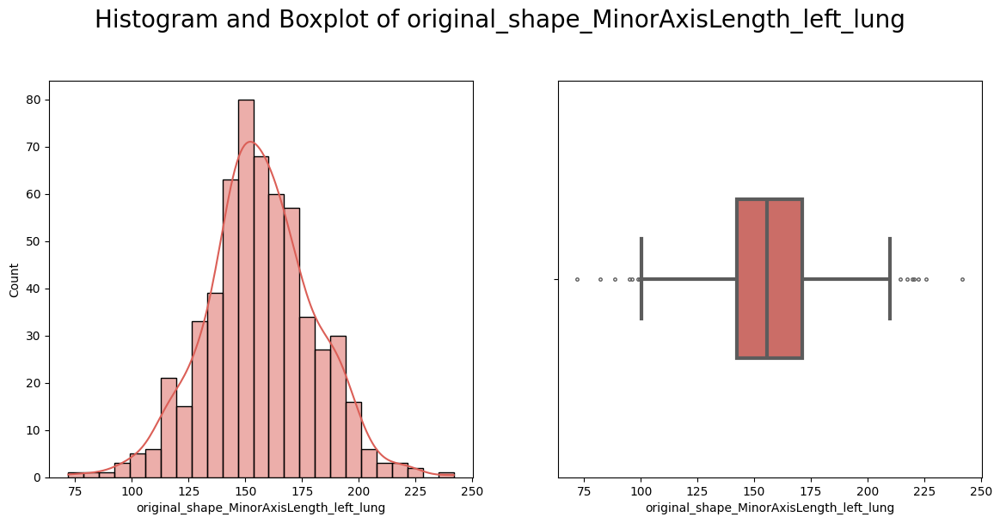

original_firstorder_MeanAbsoluteDeviation_right_lung


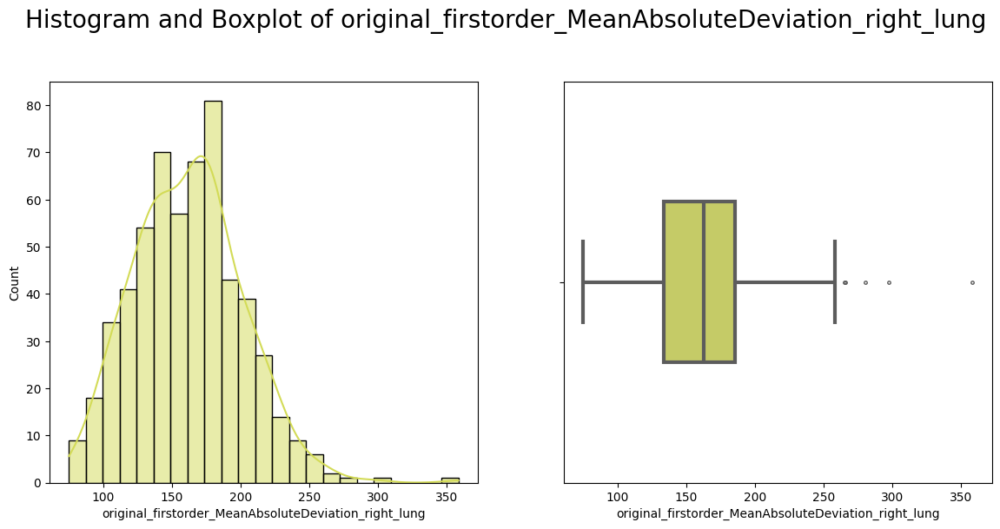

log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung


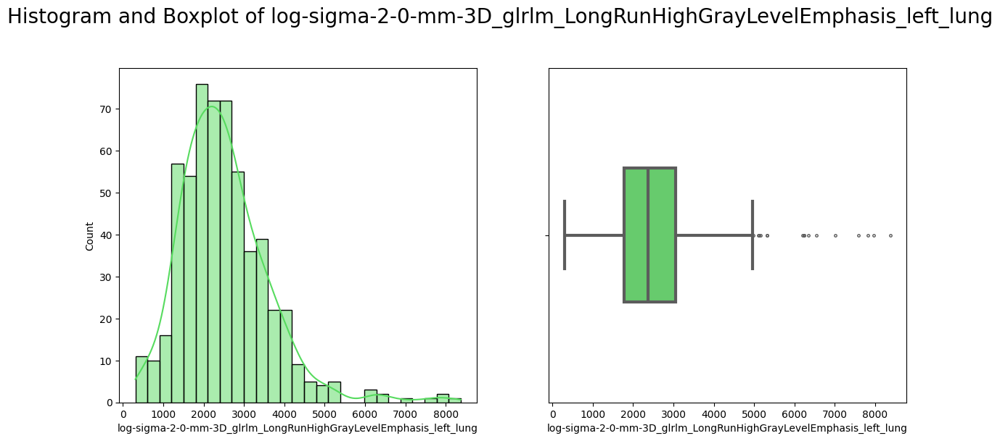

log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung


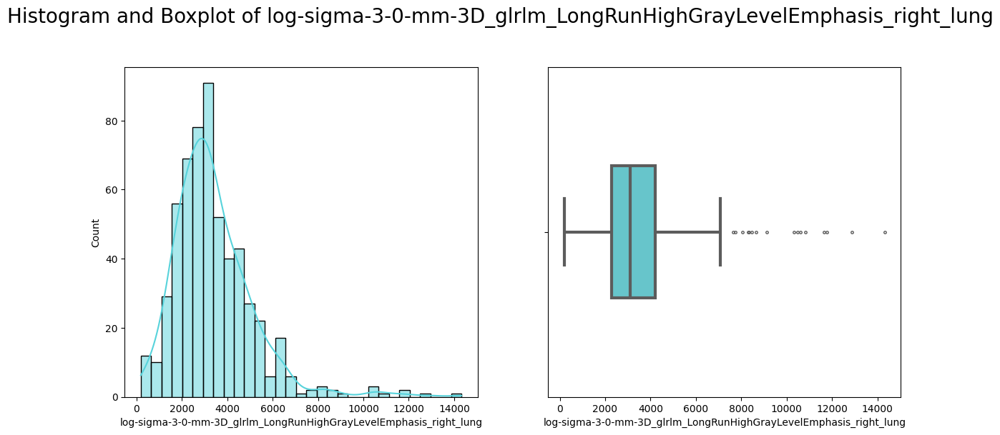

log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung


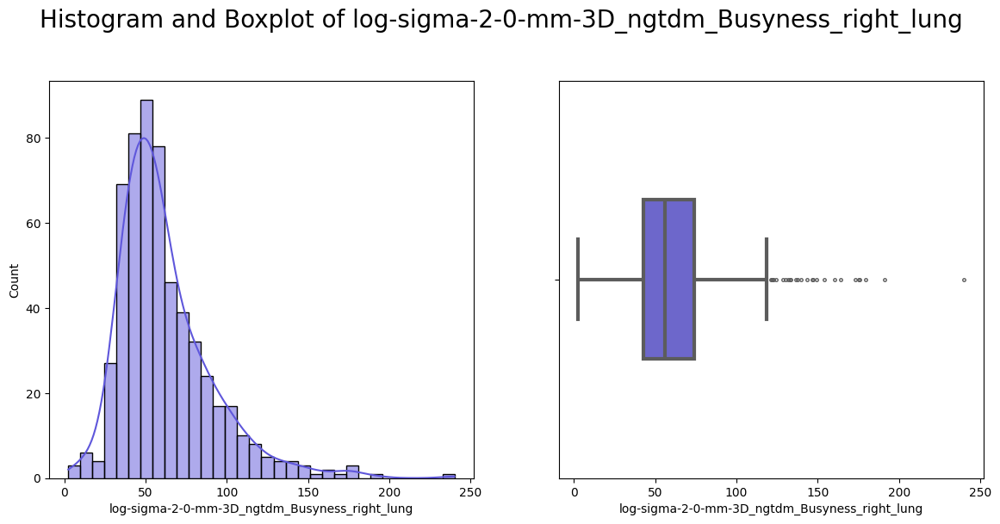

original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung


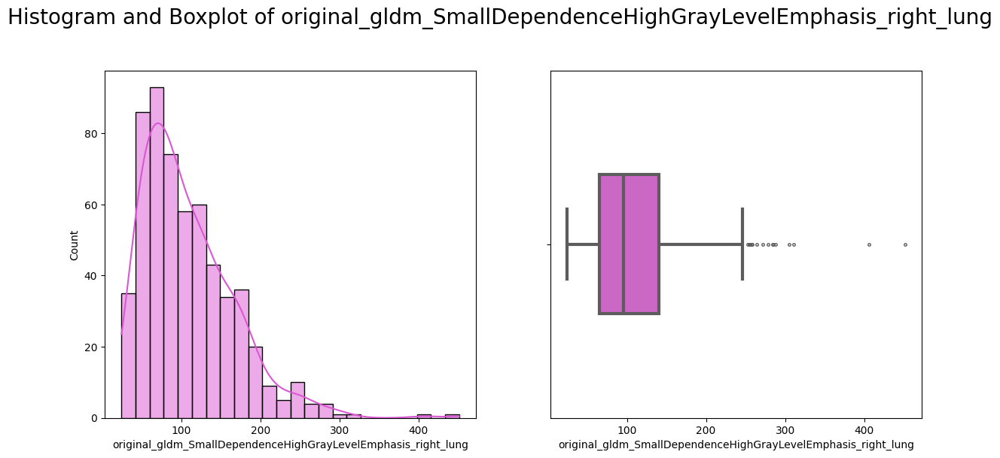

In [ ]:
for idx, col in enumerate([i for i in Selected_Radiomics_Features.columns if i != 'sex1']):
    print(col)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (14, 6))
    sns.histplot(Selected_Radiomics_Features, x = Selected_Radiomics_Features[col], kde = True,
                 color = sns.color_palette("hls", len([i for i in Selected_Radiomics_Features.columns if i != 'sex1']))[idx], ax = ax1)
    sns.boxplot(x = Selected_Radiomics_Features[col], width = 0.4, linewidth = 3, fliersize = 2.5,
                color = sns.color_palette("hls", len([i for i in Selected_Radiomics_Features.columns if i != 'sex1']))[idx], ax = ax2)
    fig.suptitle(f"Histogram and Boxplot of {col}", size = 20, y = 1.02)
    plt.show()

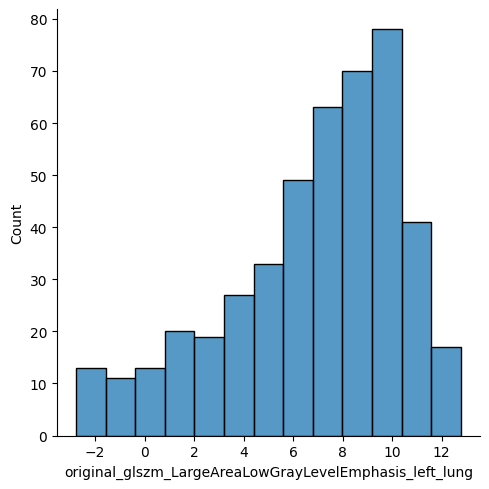

In [ ]:
X_train["original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung"] = np.log(X_train["original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung"])
sns.displot(X_train["original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung"])
plt.show()

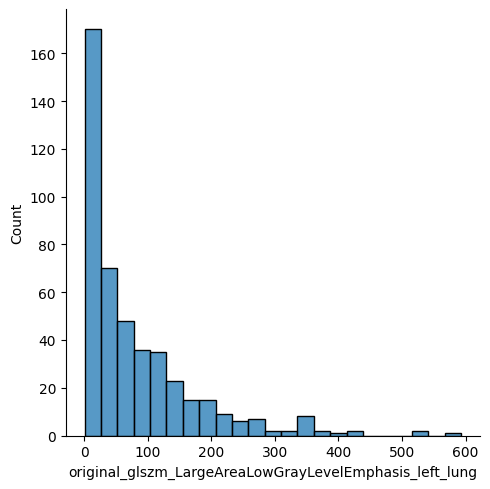

In [ ]:
X_train["original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung"] = np.sqrt(X_train["original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung"])
sns.displot(X_train["original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung"])
plt.show()

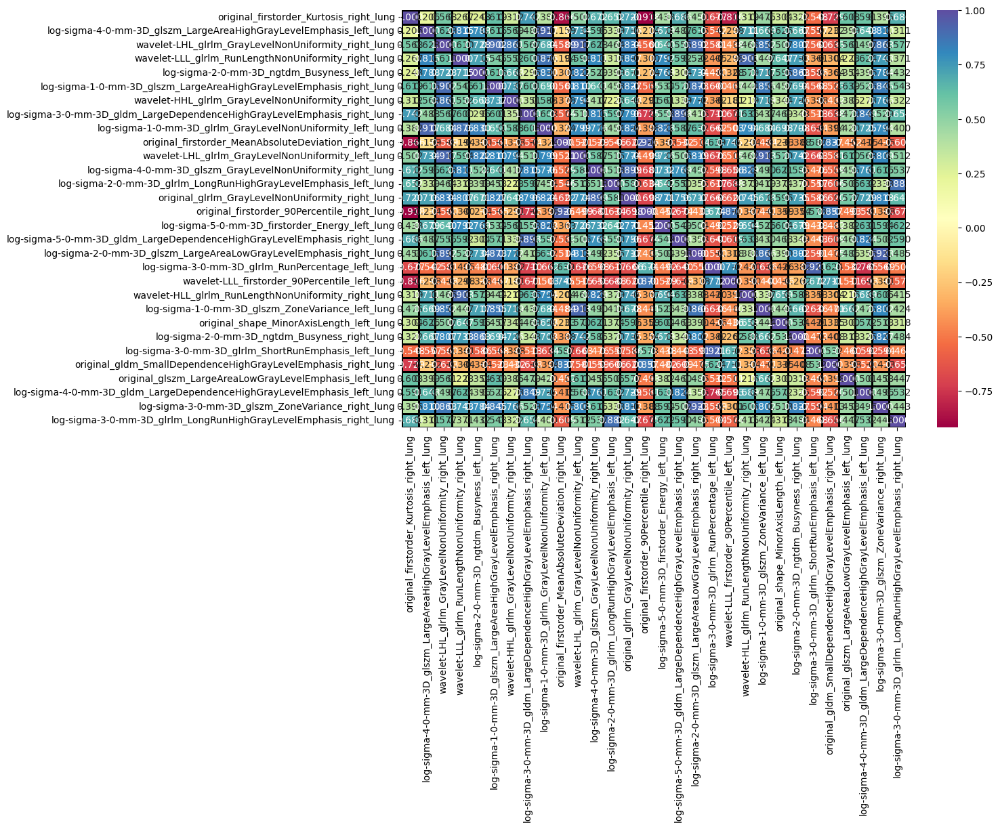

In [ ]:
plt.figure(figsize = (12, 8))
sns.heatmap(Selected_Radiomics_Features.corr(), annot = True, cmap = "Spectral", linewidths = 2, linecolor = "#000000", fmt='.3f')
plt.show()

In [ ]:

sns.pairplot(Selected_Radiomics_Features)
plt.show()

In [ ]:
stat, p = shapiro(X_train['log-sigma-1-0-mm-3D_glszm_ZoneVariance_left_lung'])
print('Statistics=%.3f, p=%.3f' % (stat, p))
# interpret
alpha = 0.05
if p > alpha:
    print('Sample looks normally distributed (fail to reject H0)')
else:
    print('Sample does not look normally distributed (reject H0)')

Statistics=0.586, p=0.000
Sample does not look normally distributed (reject H0)


In [ ]:
stat, p = shapiro(np.log(X_train['log-sigma-1-0-mm-3D_glszm_ZoneVariance_left_lung'])) ### REPLACE WITH YOUR CODE ###
print('Statistics=%.3f, p=%.3f' % (stat, p))
# interpret
alpha = 0.05
if p > alpha:
    print('Sample looks normally distributed (fail to reject H0)')
else:
    print('Sample does not look normally distributed (reject H0)')

Statistics=0.718, p=0.000
Sample does not look normally distributed (reject H0)


In [ ]:
import numpy as np
import pandas as pd
from scipy.stats import boxcox
from scipy.stats import shapiro

# Example: your feature column
x = X_train['Age'].values

# Box–Cox requires strictly positive values
x = x[x > 0]

# Apply Box–Cox
x_transformed, lambda_val = boxcox(x)

print("Lambda used:", lambda_val)

# Test normality again
stat, p = shapiro(x_transformed)
print('Statistics=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print("Looks normally distributed")
else:
    print("Still not normal")

In [ ]:
# linear regression with median fill, and using the log of 's3'
X_train, X_test, y_train, y_test = joblib.load("data_splits.pkl")
log_list = ['original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-1-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung']

X_train[log_list] = np.log(X_train[log_list])
X_test[log_list] = np.log(X_test[log_list])

X_train[radiomics_features]
# Fit an instance of `LinearRegression`
reg = LinearRegression().fit(X_train[radiomics_features], y_train)
# Generate predictions
pred = reg.predict(X_test[radiomics_features])
# Calculate the root mean squared error
root_mean_squared_error(y_test,pred)

0.6387093023675992

In [ ]:
import pandas as pd
from sklearn.preprocessing import PowerTransformer
X_train, X_test, y_train, y_test = joblib.load("data_splits.pkl")
# Suppose you want to transform these columns
cols_to_transform = ['original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-1-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung']

# Initialize transformer (Box–Cox requires strictly positive values)
pt = PowerTransformer(method='box-cox')

# Fit on training data (only selected columns)
X_train_transformed = X_train.copy()
X_test_transformed = X_test.copy()

X_train_transformed[cols_to_transform] = pt.fit_transform(X_train[cols_to_transform])
X_test_transformed[cols_to_transform] = pt.transform(X_test[cols_to_transform])

# Shapes remain the same
print("Train shape:", X_train_transformed.shape)
print("Test shape:", X_test_transformed.shape)



X_train_transformed[radiomics_features]
# Fit an instance of `LinearRegression`
reg = LinearRegression().fit(X_train_transformed[radiomics_features], y_train)
# Generate predictions
pred = reg.predict(X_test_transformed[radiomics_features])
# Calculate the root mean squared error
root_mean_squared_error(y_test,pred)

Train shape: (454, 2660)
Test shape: (114, 2660)


0.6382565716236388

### PAM Clustering Algorithm

100%|██████████| 30/30 [00:01<00:00, 24.60it/s]


PAM representatives: 120
After mRMR: 30
After VIF: 6
After VIF: ['wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_left_lung', 'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung']
Final feature set shape: (454, 6)


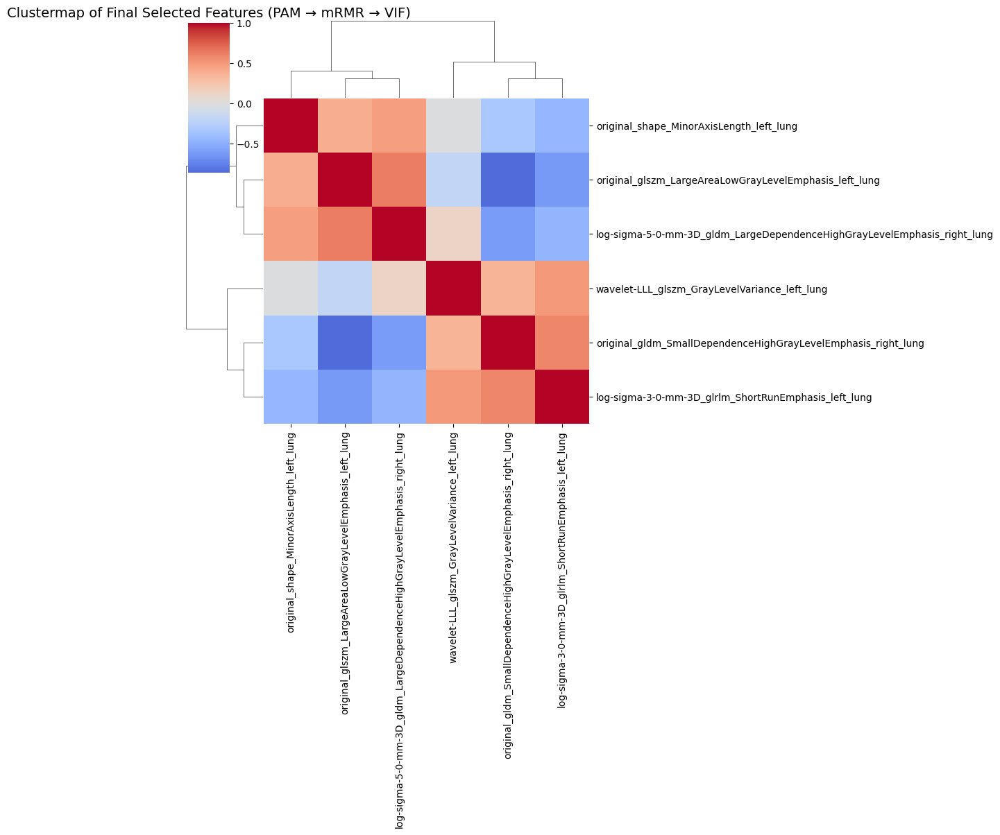

In [ ]:
# -----------------------------
# PAM Feature Selection
# -----------------------------
def pam_feature_selection_pyclust(X_train, y_train=None, k=150, use_outcome=False, random_state=42):
    """
    Run PAM (k-medoids) clustering on features to select representatives.
    Fit only on training data.
    """
    # Spearman correlation and distance matrix
    corr = X_train.corr(method="spearman").abs().fillna(0.0)
    dist = 1.0 - corr.values
    np.fill_diagonal(dist, 0.0)

    # Initial medoids
    rng = np.random.default_rng(random_state)
    initial_medoids = rng.choice(range(len(X_train.columns)), size=k, replace=False).tolist()

    # Run k-medoids
    kmedoids_instance = kmedoids(dist, initial_medoids, data_type='distance_matrix')
    kmedoids_instance.process()

    clusters = kmedoids_instance.get_clusters()
    medoids = kmedoids_instance.get_medoids()

    # Representatives
    reps = X_train.columns[medoids].tolist()

    # Outcome-aware representatives
    if use_outcome and (y_train is not None):
        reps_outcome = []
        for cluster in clusters:
            feats = X_train.columns[cluster]
            corrs_to_y = X_train[feats].apply(lambda col: abs(col.corr(y_train)))
            corrs_to_y = corrs_to_y.dropna()  # drop NaN correlations
            if not corrs_to_y.empty:
                reps_outcome.append(corrs_to_y.idxmax())
        reps = reps_outcome

    # Drop any NaN or invalid reps
    reps = [r for r in reps if r in X_train.columns]

    return reps, clusters, dist


# -----------------------------
# mRMR Feature Selection
# -----------------------------
def run_mrmr(X, y, n_features=50):
    """
    Run mRMR regression to select top n_features.
    """
    # Ensure no NaNs
    X = X.fillna(0)
    selected_features = mrmr_regression(
        X=X,
        y=y,
        K=n_features
    )
    return selected_features


# -----------------------------
# VIF Filtering
# -----------------------------
def run_vif(X, threshold=10.0):
    """
    Calculate VIF and keep features below threshold.
    """
    X_values = X.values
    vif_data = pd.DataFrame()
    vif_data["feature"] = X.columns
    vif_data["VIF"] = [variance_inflation_factor(X_values, i) for i in range(X_values.shape[1])]
    low_vif_features = vif_data.loc[vif_data["VIF"] < threshold, "feature"].tolist()
    return low_vif_features, vif_data


# -----------------------------
# Full Pipeline: PAM → mRMR → VIF
# -----------------------------
def feature_selection_pipeline(X_train, y_train, k_pam=80, n_mrmr=70, vif_thresh=10):
    # Step 1: PAM clustering
    reps, clusters, dist = pam_feature_selection_pyclust(X_train, y_train, k=k_pam, use_outcome=True)
    X_pam = X_train[reps]

    # Step 2: mRMR
    selected_mrmr = run_mrmr(X_pam, y_train, n_features=n_mrmr)
    selected_mrmr = [f for f in selected_mrmr if f in X_pam.columns]  # safety check
    X_mrmr = X_pam[selected_mrmr]

    # Step 3: VIF
    low_vif_features, vif_table = run_vif(X_mrmr, threshold=vif_thresh)
    X_final = X_mrmr[low_vif_features]

    return X_pam, X_final, reps, selected_mrmr, low_vif_features, vif_table

# Run the full pipeline on training data
X_pam, X_final, reps, selected_mrmr, low_vif_features, vif_table = feature_selection_pipeline(
    X_train_scaled, y_train, k_pam=120, n_mrmr=30, vif_thresh=10
)

print("PAM representatives:", len(reps))
print("After mRMR:", reps)
print("After mRMR:", len(selected_mrmr))
print("After mRMR:", selected_mrmr)
print("After VIF:", len(low_vif_features))
print("After VIF:", low_vif_features)
print("Final feature set shape:", X_final.shape)

# Apply the same reduced feature set to test data
X_test_final = X_test_scaled[low_vif_features]

# Optional: visualize correlation of final features
sns.clustermap(X_final.corr(method="spearman"), cmap="coolwarm", center=0, figsize=(12, 12))
plt.title("Clustermap of Final Selected Features (PAM → mRMR → VIF)", fontsize=14)
plt.show()


In [ ]:
print("After mRMR:", selected_mrmr)

After mRMR: ['original_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_left_lung', 'log-sigma-5-0-mm-3D_firstorder_Energy_left_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_left_lung', 'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_left_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-4-0-mm-3D_glszm_GrayLevelNonUniformity_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung', 'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung', 'wavelet-LLL_glrlm_RunLengthNonUniformity_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-4-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_left_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_r

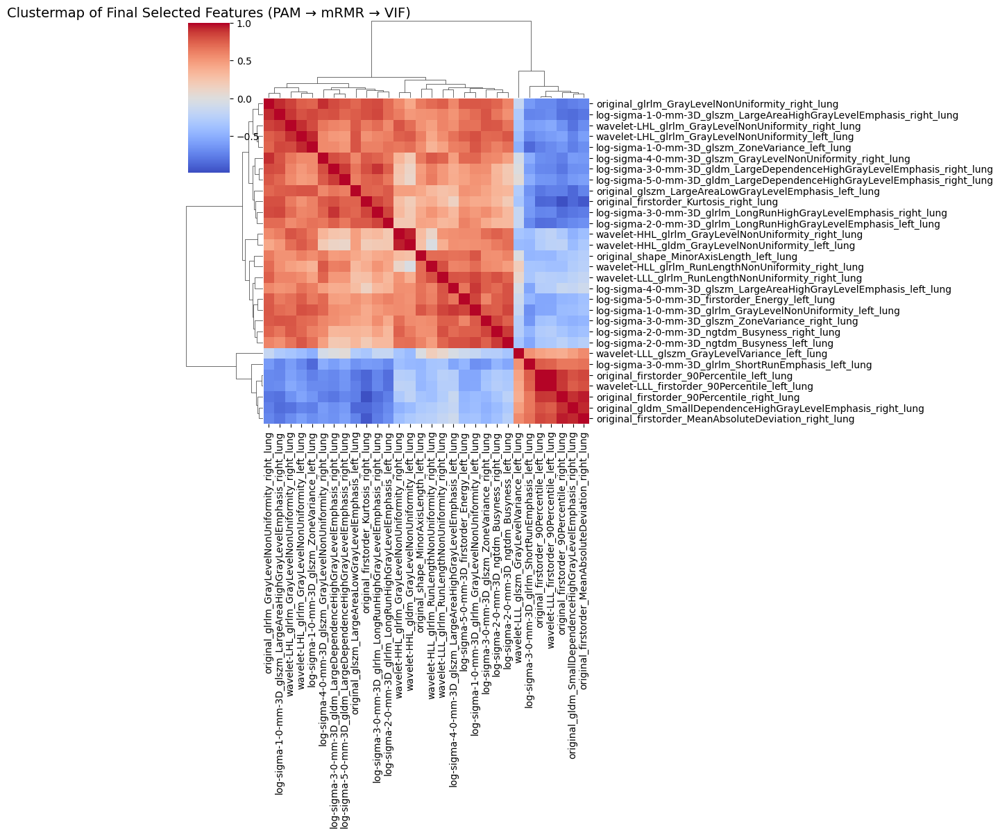

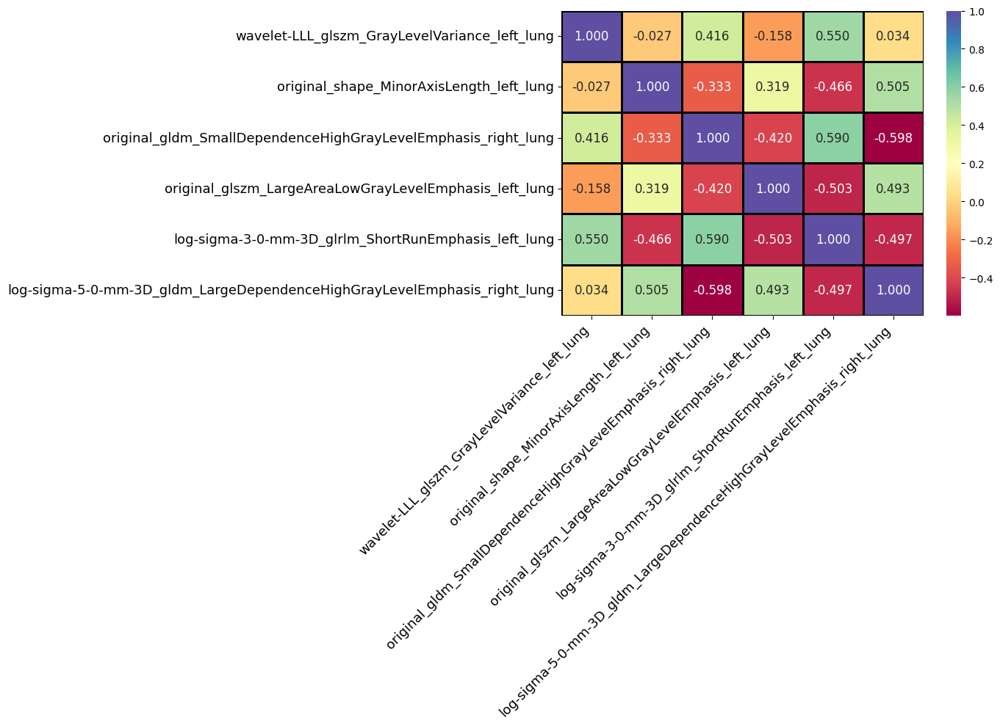

In [ ]:
['wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_left_lung', 'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung']

framr = X_train_scaled.copy()
sns.clustermap(framr[['original_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_left_lung', 'log-sigma-5-0-mm-3D_firstorder_Energy_left_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_left_lung', 'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_left_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-4-0-mm-3D_glszm_GrayLevelNonUniformity_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung', 'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung', 'wavelet-LLL_glrlm_RunLengthNonUniformity_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-4-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_left_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-3-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung', 'original_firstorder_Kurtosis_right_lung', 'log-sigma-1-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung', 'original_firstorder_90Percentile_left_lung', 'wavelet-HLL_glrlm_RunLengthNonUniformity_right_lung', 'wavelet-HHL_gldm_GrayLevelNonUniformity_left_lung', 'original_firstorder_MeanAbsoluteDeviation_right_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-1-0-mm-3D_glszm_ZoneVariance_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung', 'wavelet-LLL_firstorder_90Percentile_left_lung']].corr(method="spearman"), cmap="coolwarm", center=0, figsize=(12, 12))
plt.title("Clustermap of Final Selected Features (PAM → mRMR → VIF)", fontsize=14)
plt.show()

import matplotlib.pyplot as plt
import seaborn as sns

# Set the figure size slightly larger to accommodate larger fonts
plt.figure(figsize=(14, 10))

# 1. Use 'annot_kws' to increase the font size of the numbers inside the boxes
ax = sns.heatmap(
    framr[[
        'wavelet-LLL_glszm_GrayLevelVariance_left_lung', 
        'original_shape_MinorAxisLength_left_lung', 
        'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung', 
        'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 
        'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 
        'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung'
    ]].corr(), 
    annot=True, 
    cmap="Spectral", 
    linewidths=2, 
    linecolor="#000000", 
    fmt='.3f',
    annot_kws={"size": 12}  # Font size of numbers inside heatmap
)

# 2. Increase font size of feature names on X and Y axes
# Added rotation=45 and ha='right' to prevent long names from overlapping
plt.xticks(fontsize=13, rotation=45, ha='right')
plt.yticks(fontsize=13)

# 3. Optional: Increase title font size
# plt.title("Correlation Heatmap of Selected Features", fontsize=16, pad=20)

# 4. Use tight_layout to ensure long labels are not truncated in the saved image
plt.tight_layout()

plt.show()

PAM representatives: 120
After ANOVA: 30
After ANOVA: Index(['original_firstorder_Kurtosis_right_lung',
       'log-sigma-4-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_left_lung',
       'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung',
       'wavelet-LLL_glrlm_RunLengthNonUniformity_right_lung',
       'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung',
       'log-sigma-1-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung',
       'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung',
       'log-sigma-3-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung',
       'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_left_lung',
       'original_firstorder_MeanAbsoluteDeviation_right_lung',
       'wavelet-LHL_glrlm_GrayLevelNonUniformity_left_lung',
       'log-sigma-4-0-mm-3D_glszm_GrayLevelNonUniformity_right_lung',
       'log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung',
       'original_glrlm_GrayLevelNonUniformity_right_lung',
       'original_fir

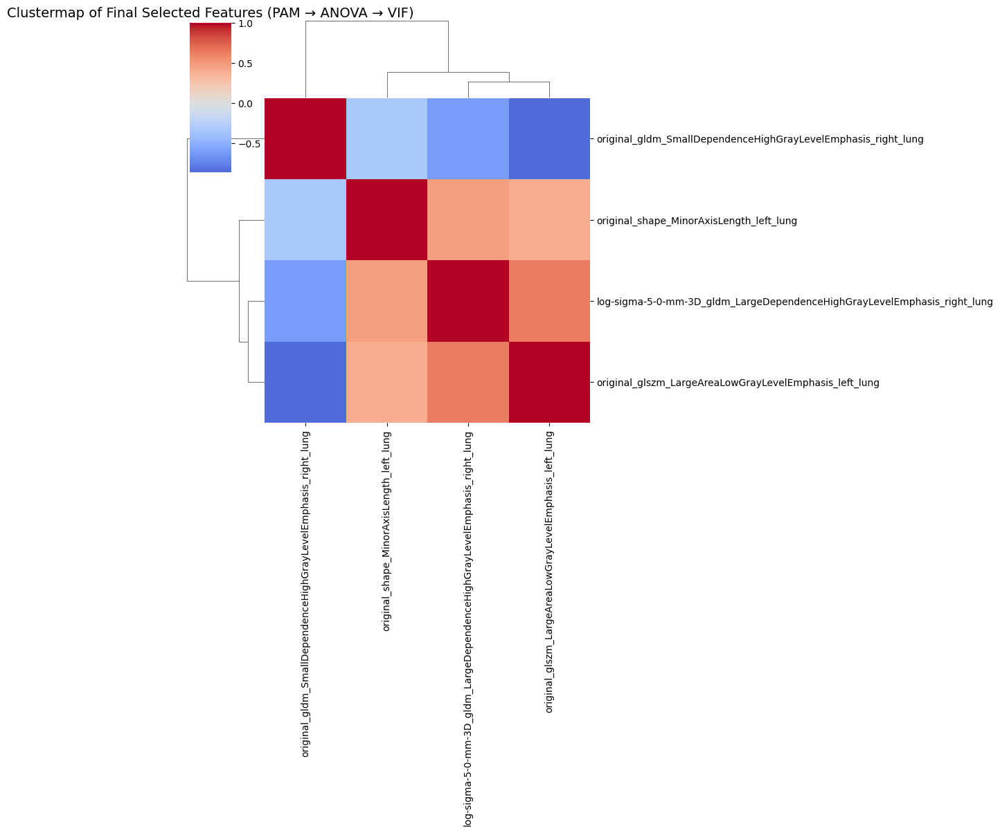

In [ ]:
#PAM → ANOVA → VIF

# -----------------------------
# ANOVA Feature Selection
# -----------------------------
def run_anova(X, y, n_features):
    """
    Run ANOVA F-test (for regression targets) to select top n_features.
    """
    selector = SelectKBest(score_func=f_regression, k=n_features)
    X_selected = selector.fit_transform(X, y)
    selected_features = X.columns[selector.get_support()]
    f_scores = selector.scores_[selector.get_support()]
    return X_selected, selected_features, f_scores, selector


# -----------------------------
# VIF Filtering
# -----------------------------
def run_vif(X, threshold=10.0):
    """
    Calculate VIF and keep features below threshold.
    """
    X_values = X.values
    vif_data = pd.DataFrame()
    vif_data["feature"] = X.columns
    vif_data["VIF"] = [variance_inflation_factor(X_values, i) for i in range(X_values.shape[1])]
    low_vif_features = vif_data.loc[vif_data["VIF"] < threshold, "feature"].tolist()
    return low_vif_features, vif_data


# -----------------------------
# Full Pipeline: PAM → ANOVA → VIF
# -----------------------------
def feature_selection_pipeline(X_pam, y_train, k_pam=120, n_anova=80, vif_thresh=10):
    # # Step 1: PAM clustering
    # reps, clusters, dist = pam_feature_selection_pyclust(X_train, y_train, k=k_pam, use_outcome=True)
    # X_pam = X_train[reps]

    # Step 2: ANOVA
    _, selected_anova, f_scores, selector = run_anova(X_pam, y_train, n_features=n_anova)
    X_anova = X_pam[selected_anova]

    # Step 3: VIF
    low_vif_features, vif_table = run_vif(X_anova, threshold=vif_thresh)
    X_final = X_anova[low_vif_features]

    return X_final, reps, selected_anova, low_vif_features, vif_table, f_scores


# Run the full pipeline on training data
X_final, reps, selected_anova, low_vif_features, vif_table, f_scores = feature_selection_pipeline(
    X_pam, y_train, k_pam=120, n_anova=30, vif_thresh=10
)

print("PAM representatives:", len(reps))
print("After ANOVA:", len(selected_anova))
print("After ANOVA:", selected_anova)
print("After VIF:", len(low_vif_features))
print("After VIF:", low_vif_features)
print("Final feature set shape:", X_final.shape)

# Apply the same reduced feature set to test data
X_test_final = X_test_scaled[low_vif_features]

# Optional: visualize correlation of final features
sns.clustermap(X_final.corr(method="spearman"), cmap="coolwarm", center=0, figsize=(12, 12))
plt.title("Clustermap of Final Selected Features (PAM → ANOVA → VIF)", fontsize=14)
plt.show()



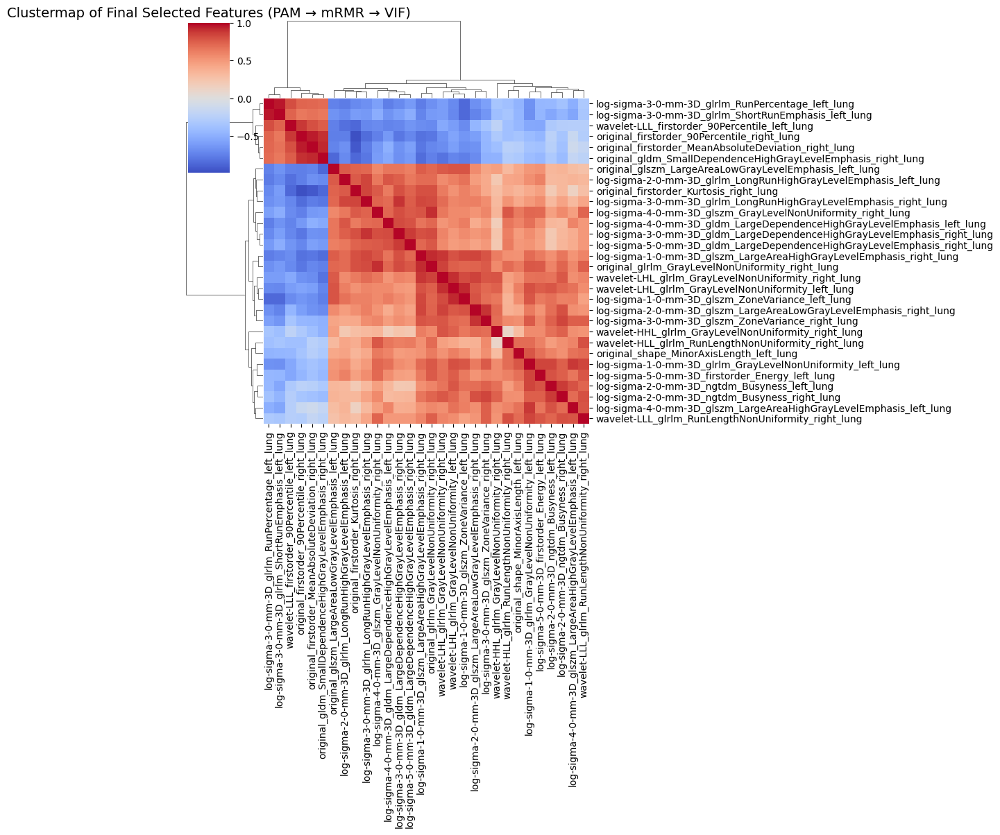

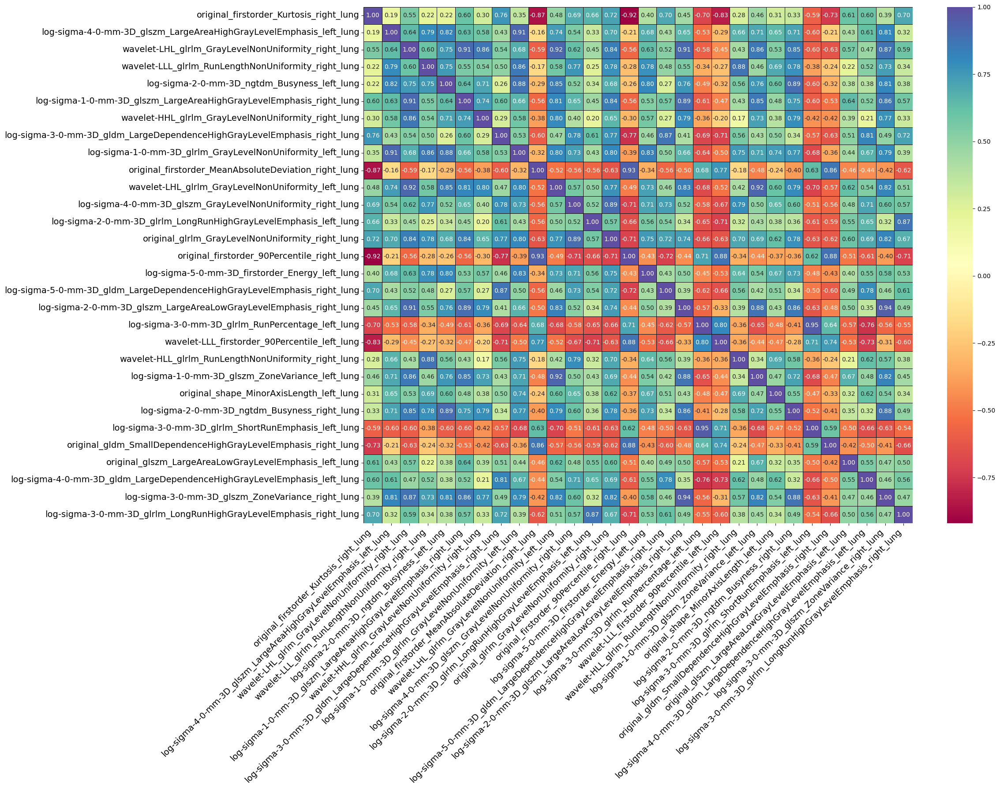

In [ ]:
framr = X_train_scaled.copy()
sns.clustermap(framr[['original_firstorder_Kurtosis_right_lung',
       'log-sigma-4-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_left_lung',
       'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung',
       'wavelet-LLL_glrlm_RunLengthNonUniformity_right_lung',
       'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung',
       'log-sigma-1-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung',
       'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung',
       'log-sigma-3-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung',
       'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_left_lung',
       'original_firstorder_MeanAbsoluteDeviation_right_lung',
       'wavelet-LHL_glrlm_GrayLevelNonUniformity_left_lung',
       'log-sigma-4-0-mm-3D_glszm_GrayLevelNonUniformity_right_lung',
       'log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung',
       'original_glrlm_GrayLevelNonUniformity_right_lung',
       'original_firstorder_90Percentile_right_lung',
       'log-sigma-5-0-mm-3D_firstorder_Energy_left_lung',
       'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung',
       'log-sigma-2-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung',
       'log-sigma-3-0-mm-3D_glrlm_RunPercentage_left_lung',
       'wavelet-LLL_firstorder_90Percentile_left_lung',
       'wavelet-HLL_glrlm_RunLengthNonUniformity_right_lung',
       'log-sigma-1-0-mm-3D_glszm_ZoneVariance_left_lung',
       'original_shape_MinorAxisLength_left_lung',
       'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung',
       'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung',
       'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung',
       'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung',
       'log-sigma-4-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung',
       'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung',
       'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung']].corr(method="spearman"), cmap="coolwarm", center=0, figsize=(12, 12))
plt.title("Clustermap of Final Selected Features (PAM → mRMR → VIF)", fontsize=14)
plt.show()

import matplotlib.pyplot as plt
import seaborn as sns

# 1. Significantly increase figure size for 30 features
plt.figure(figsize=(24, 18))

# Define your feature list
features = [
    'original_firstorder_Kurtosis_right_lung',
    'log-sigma-4-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_left_lung',
    'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung',
    'wavelet-LLL_glrlm_RunLengthNonUniformity_right_lung',
    'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung',
    'log-sigma-1-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung',
    'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung',
    'log-sigma-3-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung',
    'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_left_lung',
    'original_firstorder_MeanAbsoluteDeviation_right_lung',
    'wavelet-LHL_glrlm_GrayLevelNonUniformity_left_lung',
    'log-sigma-4-0-mm-3D_glszm_GrayLevelNonUniformity_right_lung',
    'log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung',
    'original_glrlm_GrayLevelNonUniformity_right_lung',
    'original_firstorder_90Percentile_right_lung',
    'log-sigma-5-0-mm-3D_firstorder_Energy_left_lung',
    'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung',
    'log-sigma-2-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung',
    'log-sigma-3-0-mm-3D_glrlm_RunPercentage_left_lung',
    'wavelet-LLL_firstorder_90Percentile_left_lung',
    'wavelet-HLL_glrlm_RunLengthNonUniformity_right_lung',
    'log-sigma-1-0-mm-3D_glszm_ZoneVariance_left_lung',
    'original_shape_MinorAxisLength_left_lung',
    'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung',
    'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung',
    'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung',
    'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung',
    'log-sigma-4-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung',
    'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung',
    'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung'
]

# 2. Create heatmap with larger annotation font
# Note: annot_kws size 10 is usually the max for 30x30 matrices before overlap
ax = sns.heatmap(framr[features].corr(), 
                 annot=True, 
                 cmap="Spectral", 
                 linewidths=0.5, # Reduced linewidth to give more space to text
                 linecolor="#000000", 
                 fmt='.2f',      # Reduced to 2 decimals to save space
                 annot_kws={"size": 10}) 

# 3. Increase font size of feature names (Axis Labels)
plt.xticks(fontsize=14, rotation=45, ha='right')
plt.yticks(fontsize=14)

# 4. Increase Title font size
# plt.title("Correlation Heatmap (30 Selected Features)", fontsize=22, pad=30)

# Ensure the layout fits the long labels
plt.tight_layout()

plt.show()

### Hirarechical Clustering

Number of clusters: 304
Cluster representatives: ['original_shape_Flatness_right_lung', 'original_shape_LeastAxisLength_right_lung', 'original_shape_Maximum2DDiameterColumn_right_lung', 'original_shape_Maximum2DDiameterRow_left_lung', 'original_shape_Maximum2DDiameterSlice_right_lung', 'original_shape_VoxelVolume_right_lung', 'original_shape_MinorAxisLength_right_lung', 'original_shape_Sphericity_right_lung', 'original_shape_SurfaceArea_left_lung', 'original_shape_SurfaceVolumeRatio_left_lung', 'original_firstorder_10Percentile_right_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_right_lung', 'original_firstorder_Maximum_right_lung', 'original_firstorder_MeanAbsoluteDeviation_right_lung', 'original_firstorder_Minimum_left_lung', 'original_firstorder_Range_right_lung', 'wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'wavelet-LLL_glcm_Idn_right_lung', 'original_glcm_MCC_right_lung', 'wavelet-LHL_glcm_Idn_righ

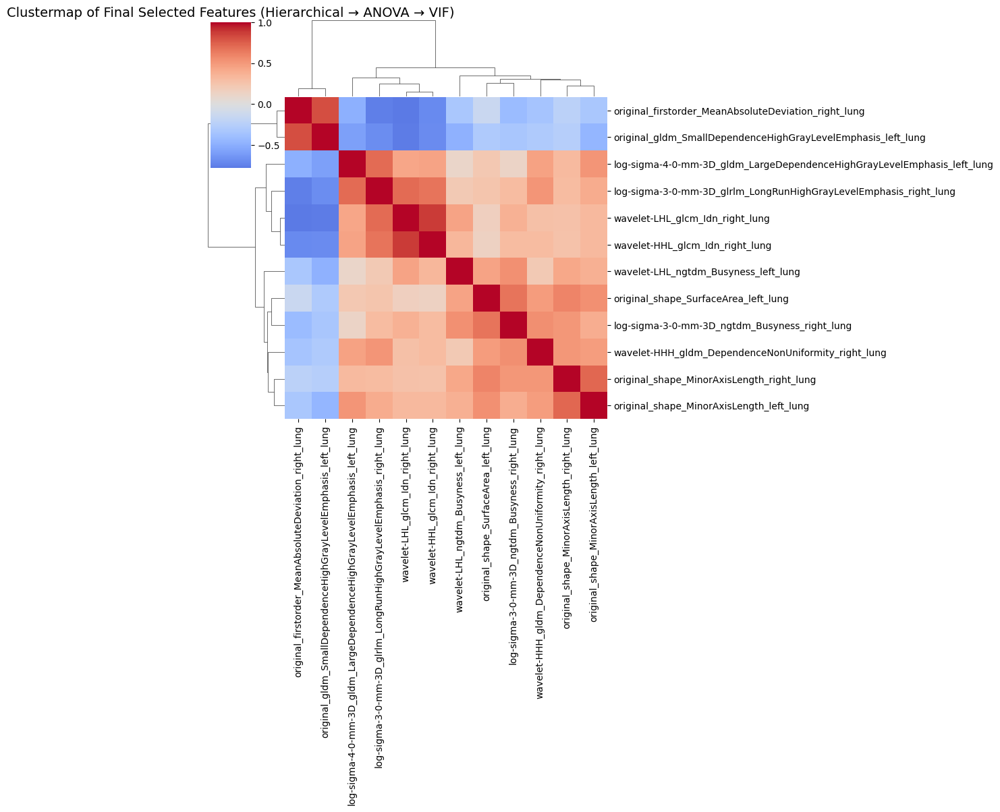

In [ ]:


# -----------------------------
# 1. Compute absolute correlation matrix (train only)
# -----------------------------
corr = X_train_scaled.corr(method="spearman").abs().fillna(0.0).clip(0, 1)

# -----------------------------
# 2. Convert to distance matrix
# -----------------------------
dist = 1 - corr.values
np.fill_diagonal(dist, 0.0)
dist_condensed = squareform(dist, checks=False)

# -----------------------------
# 3. Hierarchical clustering
# -----------------------------
linkage_matrix = linkage(dist_condensed, method='average')
# Cut dendrogram at distance threshold (0.8 = features with corr >= 0.2 grouped)
cluster_labels = fcluster(linkage_matrix, t=0.2, criterion='distance')

clusters = pd.DataFrame({
    "Feature": X_train_scaled.columns,
    "Cluster": cluster_labels
})

# -----------------------------
# 4. Pick representative feature per cluster (train only)
# -----------------------------
spearman_corr = X_train_scaled.apply(lambda col: col.corr(y_train, method="spearman"))

selected_features = []
for cluster_id in clusters["Cluster"].unique():
    cluster_feats = clusters.loc[clusters["Cluster"] == cluster_id, "Feature"]
    corrs = spearman_corr.loc[cluster_feats].dropna()
    if not corrs.empty:
        best_feat = corrs.abs().idxmax()
        selected_features.append(best_feat)

print("Number of clusters:", clusters["Cluster"].nunique())
print("Cluster representatives:", selected_features)

# -----------------------------
# 5. ANOVA feature selection (train only)
# -----------------------------
selector = SelectKBest(score_func=f_regression, k=min(30, len(selected_features)))
X_train_anova = selector.fit_transform(X_train_scaled[selected_features], y_train)
X_test_anova  = selector.transform(X_test[selected_features])

anova_features = pd.Index(selected_features)[selector.get_support()].tolist()
print("After ANOVA:", len(anova_features))
print("After ANOVA:", anova_features)
# -----------------------------
# 6. VIF filtering (train only)
# -----------------------------
X_train_anova_df = pd.DataFrame(X_train_anova, columns=anova_features, index=X_train.index)
X_test_anova_df  = pd.DataFrame(X_test_anova,  columns=anova_features, index=X_test.index)

vif_data = pd.DataFrame()
vif_data["feature"] = X_train_anova_df.columns
vif_data["VIF"] = [variance_inflation_factor(X_train_anova_df.values, i)
                   for i in range(X_train_anova_df.shape[1])]

low_vif_features = vif_data.loc[vif_data["VIF"] < 10.0, "feature"].tolist()
print("After VIF:", len(low_vif_features))
print("Cluster representatives:", low_vif_features)
# Final reduced datasets
X_train_final = X_train_anova_df[low_vif_features]
X_test_final  = X_test_anova_df[low_vif_features]

print("Final train shape:", X_train_final.shape)
print("Final test shape:", X_test_final.shape)

# -----------------------------
# 7. Optional: visualize correlation of final features
# -----------------------------
sns.clustermap(X_train_final.corr(method="spearman"), cmap="coolwarm", center=0, figsize=(12, 12))
plt.title("Clustermap of Final Selected Features (Hierarchical → ANOVA → VIF)", fontsize=14)
plt.show()


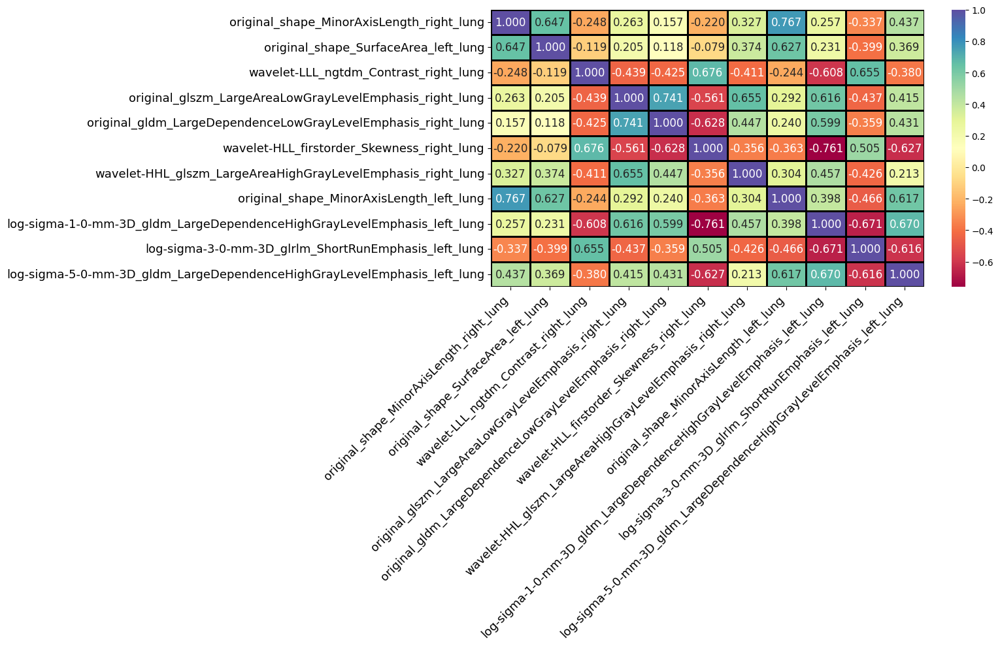

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Set a large figure size to accommodate long feature names
plt.figure(figsize=(16, 10))

# Define the feature list
features_to_plot = [
    'original_shape_MinorAxisLength_right_lung', 
    'original_shape_SurfaceArea_left_lung', 
    'wavelet-LLL_ngtdm_Contrast_right_lung', 
    'original_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 
    'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 
    'wavelet-HLL_firstorder_Skewness_right_lung', 
    'wavelet-HHL_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 
    'original_shape_MinorAxisLength_left_lung', 
    'log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 
    'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 
    'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung'
]

# 2. Create the heatmap with 'annot_kws' to increase the number font size
ax = sns.heatmap(framr[features_to_plot].corr(), 
                 annot=True, 
                 cmap="Spectral", 
                 linewidths=2, 
                 linecolor="#000000", 
                 fmt='.3f',
                 annot_kws={"size": 12}) # Font size of numbers inside the boxes

# 3. Increase font size of feature names on X and Y axes
# rotation=45 and ha='right' helps long names stay readable
plt.xticks(fontsize=13, rotation=45, ha='right')
plt.yticks(fontsize=13)

# 4. Increase Title font size for clarity
# plt.title("Correlation Heatmap of Selected Radiomic Features", fontsize=18, pad=20)

# 5. VERY IMPORTANT: Adjust layout so long names are not cut off
plt.tight_layout()

plt.show()


100%|██████████| 30/30 [00:01<00:00, 22.35it/s]


After mRMR: 30
After mRMR: ['original_shape_MinorAxisLength_left_lung', 'wavelet-HHH_glcm_MCC_right_lung', 'wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-1-0-mm-3D_gldm_GrayLevelNonUniformity_left_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung', 'original_shape_SurfaceArea_left_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'original_glszm_SmallAreaHighGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'wavelet-LLH_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_firstorder_Kurtosis_right_lung', 'wavelet-LLL_glszm_GrayLevelNonUnifor

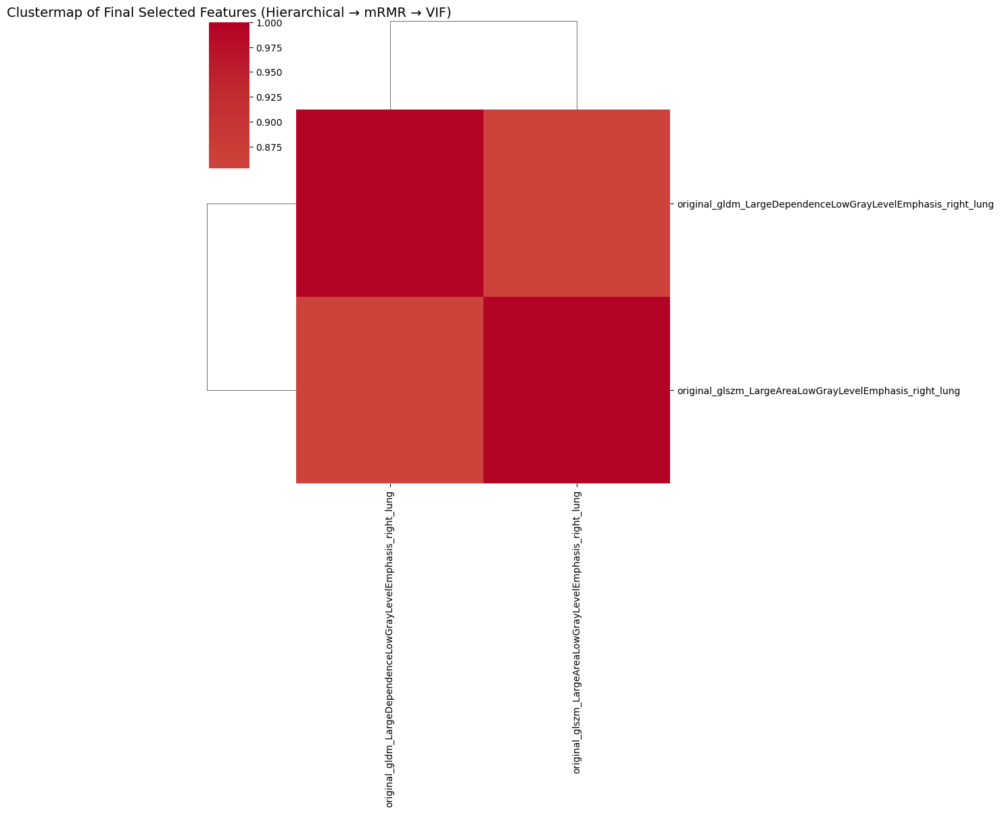

In [ ]:
X_cluster_reps = X_train[selected_features]

# -----------------------------
# 5. mRMR feature selection (train only)
# -----------------------------
# Ensure no NaNs
X_cluster_reps = X_cluster_reps.fillna(0)

selected_mrmr = mrmr_regression(
    X=X_cluster_reps,
    y=y_train,
    K=min(30, X_cluster_reps.shape[1])  # choose up to 80 or all available
)

print("After mRMR:", len(selected_mrmr))
print("After mRMR:", selected_mrmr)
X_train_mrmr = X_cluster_reps[selected_mrmr]
X_test_mrmr  = X_test[selected_mrmr]  # apply same mask to test

# -----------------------------
# 6. VIF filtering (train only)
# -----------------------------
vif_data = pd.DataFrame()
vif_data["feature"] = X_train_mrmr.columns
vif_data["VIF"] = [variance_inflation_factor(X_train_mrmr.values, i)
                   for i in range(X_train_mrmr.shape[1])]

low_vif_features = vif_data.loc[vif_data["VIF"] < 10, "feature"].tolist()
print("After VIF:", len(low_vif_features))
print("After VIF:", low_vif_features)

# Final reduced datasets
X_train_final = X_train_mrmr[low_vif_features]
X_test_final  = X_test_mrmr[low_vif_features]

print("Final train shape:", X_train_final.shape)
print("Final test shape:", X_test_final.shape)

# -----------------------------
# 7. Optional: visualize correlation of final features
# -----------------------------
sns.clustermap(X_train_final.corr(method="spearman"), cmap="coolwarm", center=0, figsize=(12, 12))
plt.title("Clustermap of Final Selected Features (Hierarchical → mRMR → VIF)", fontsize=14)
plt.show()

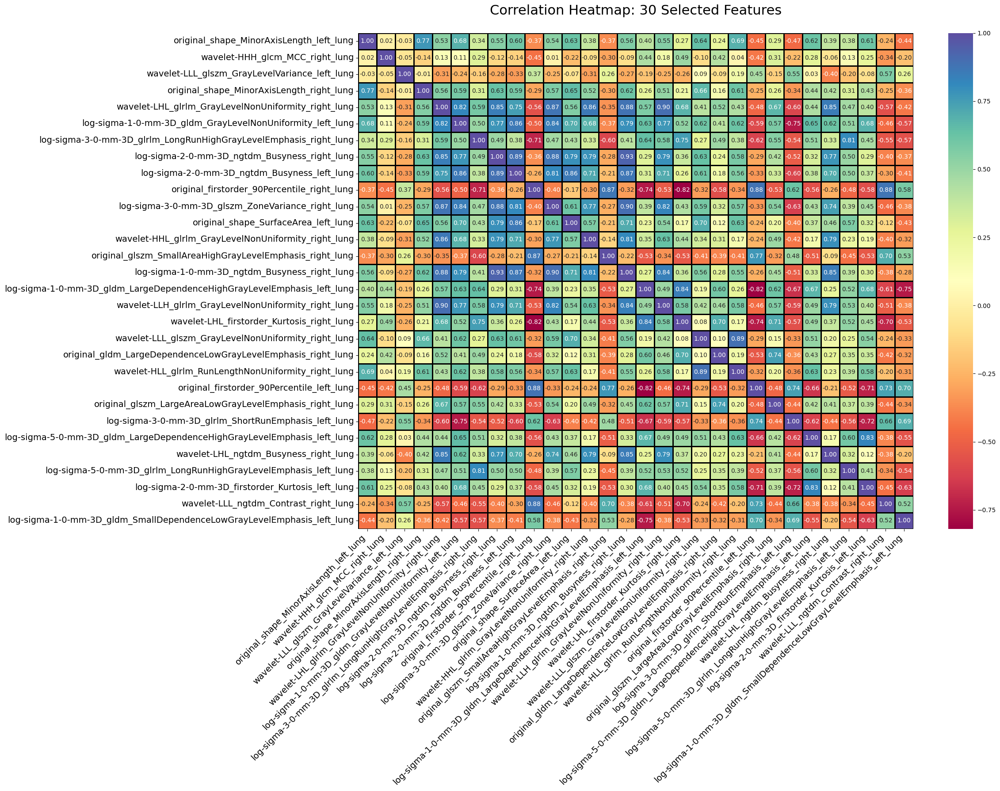

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Increase figure size significantly for 30 features
plt.figure(figsize=(24, 18))

# List of features
features = [
    'original_shape_MinorAxisLength_left_lung', 'wavelet-HHH_glcm_MCC_right_lung', 
    'wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_right_lung', 
    'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-1-0-mm-3D_gldm_GrayLevelNonUniformity_left_lung', 
    'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung', 
    'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung', 'original_firstorder_90Percentile_right_lung', 
    'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung', 'original_shape_SurfaceArea_left_lung', 
    'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'original_glszm_SmallAreaHighGrayLevelEmphasis_right_lung', 
    'log-sigma-1-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 
    'wavelet-LLH_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_firstorder_Kurtosis_right_lung', 
    'wavelet-LLL_glszm_GrayLevelNonUniformity_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 
    'wavelet-HLL_glrlm_RunLengthNonUniformity_right_lung', 'original_firstorder_90Percentile_left_lung', 
    'original_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 
    'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'wavelet-LHL_ngtdm_Busyness_right_lung', 
    'log-sigma-5-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung', 'log-sigma-2-0-mm-3D_firstorder_Kurtosis_left_lung', 
    'wavelet-LLL_ngtdm_Contrast_right_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung'
]

# 2. Plot heatmap with larger 'annot_kws' for the correlation values
ax = sns.heatmap(framr[features].corr(), 
                 annot=True, 
                 cmap="Spectral", 
                 linewidths=1, 
                 linecolor="#000000", 
                 fmt='.2f',             # Using 2 decimals saves horizontal space
                 annot_kws={"size": 10}) # Font size of numbers inside the heatmap

# 3. Increase font size of feature names (X and Y axis labels)
# rotation=45 and ha='right' prevent the long names from crashing into each other
plt.xticks(fontsize=14, rotation=45, ha='right')
plt.yticks(fontsize=14)

# 4. Increase Title font size
plt.title("Correlation Heatmap: 30 Selected Features", fontsize=22, pad=30)

# 5. Tight layout ensures labels aren't cut off at the edges
plt.tight_layout()

plt.show()


100%|██████████| 1/1 [00:00<00:00, 1449.31it/s]


Number of clusters: 304
Selected features (mRMR reps): ['original_shape_Flatness_right_lung', 'original_shape_LeastAxisLength_left_lung', 'original_shape_Maximum2DDiameterColumn_right_lung', 'original_shape_Maximum2DDiameterRow_left_lung', 'original_shape_Maximum2DDiameterSlice_right_lung', 'log-sigma-2-0-mm-3D_glrlm_GrayLevelNonUniformity_right_lung', 'original_shape_MinorAxisLength_right_lung', 'original_shape_Sphericity_right_lung', 'original_shape_SurfaceArea_left_lung', 'original_shape_SurfaceVolumeRatio_right_lung', 'original_firstorder_10Percentile_right_lung', 'log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_right_lung', 'original_firstorder_Maximum_right_lung', 'original_firstorder_MeanAbsoluteDeviation_right_lung', 'original_firstorder_Minimum_right_lung', 'original_firstorder_Range_right_lung', 'wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'wavelet-LLL_glcm_DifferenceEntropy_right_lung', 'original_glcm_

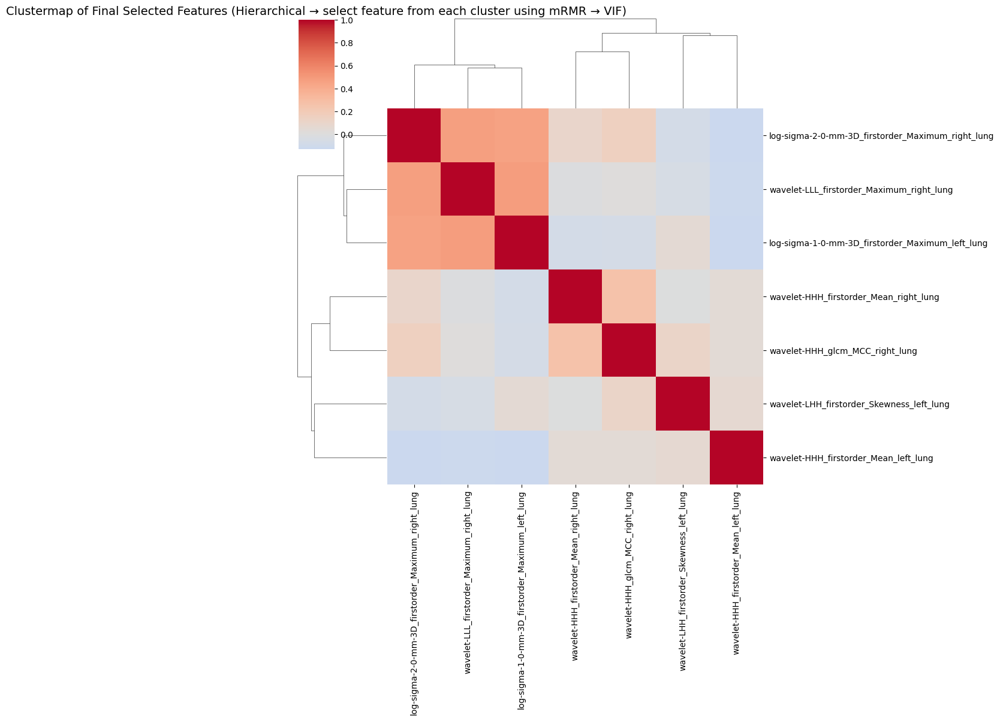

In [ ]:


selected_features_mrmr = []

for cluster_id in clusters["Cluster"].unique():
    cluster_feats = clusters.loc[clusters["Cluster"] == cluster_id, "Feature"].tolist()
    
    # Subset the cluster features
    X_cluster = X_train_scaled[cluster_feats].fillna(0)  # ensure no NaNs
    
    if X_cluster.shape[1] == 1:
        # Only one feature in this cluster → take it directly
        selected_features_mrmr.append(cluster_feats[0])
    else:
        # Run mRMR inside this cluster
        selected = mrmr_regression(X=X_cluster, y=y_train, K=1)
        if selected:  # safety check
            selected_features_mrmr.extend(selected)

print("Number of clusters:", clusters["Cluster"].nunique())
print("Selected features (mRMR reps):", selected_features_mrmr)

X_train_cluster_mrmr = X_train_scaled[selected_features_mrmr]
X_test_cluster_mrmr  = X_test[selected_features_mrmr]

# -----------------------------
# VIF filtering (train only)
# -----------------------------
vif_data = pd.DataFrame()
vif_data["feature"] = X_train_cluster_mrmr.columns
vif_data["VIF"] = [variance_inflation_factor(X_train_cluster_mrmr.values, i)
                   for i in range(X_train_cluster_mrmr.shape[1])]

low_vif_features = vif_data.loc[vif_data["VIF"] < 15, "feature"].tolist()
print("After VIF:", len(low_vif_features))
print("After VIF:", low_vif_features)
# Final reduced datasets
X_train_final_cluster_mrmr = X_train_cluster_mrmr[low_vif_features]
X_test_final_cluster_mrmr  = X_test_cluster_mrmr[low_vif_features]

print("Final train shape:", X_train_final_cluster_mrmr.shape)
print("Final test shape:", X_test_final_cluster_mrmr.shape)

# -----------------------------
# Optional: visualize correlation
# -----------------------------
sns.clustermap(X_train_final_cluster_mrmr.corr(method="spearman"), cmap="coolwarm", center=0, figsize=(12, 12))
plt.title("Clustermap of Final Selected Features (Hierarchical → select feature from each cluster using mRMR → VIF)", fontsize=14)
plt.show()


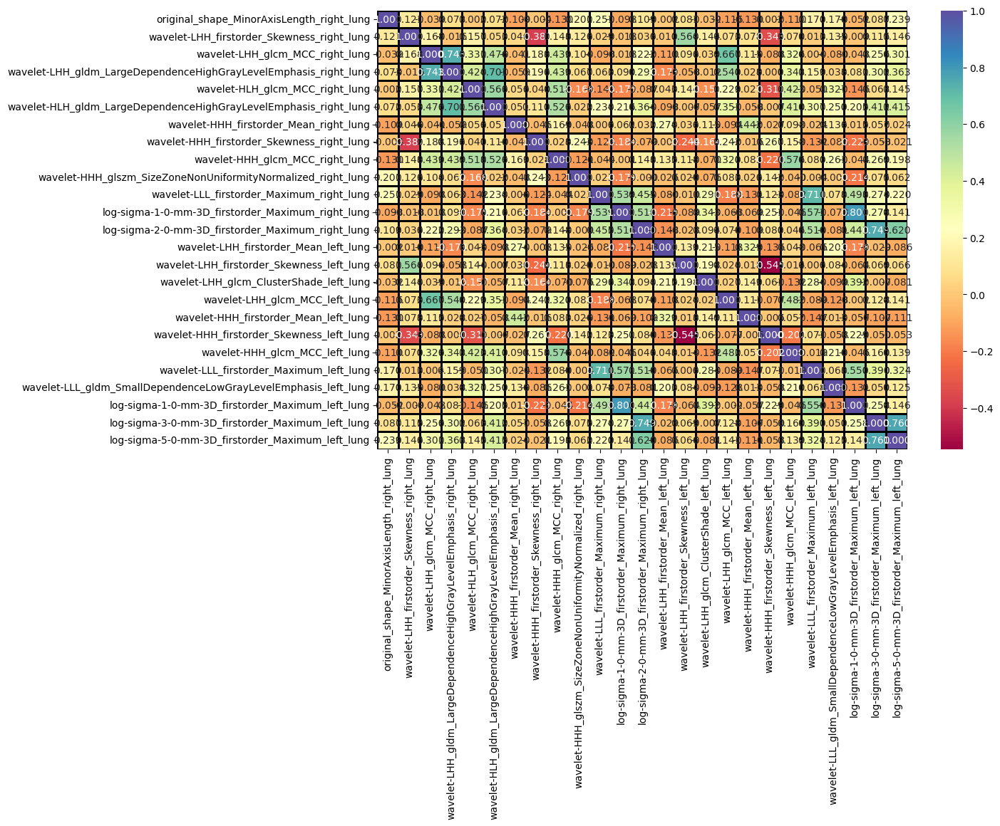

In [ ]:

framr = X_train_scaled.copy()
plt.figure(figsize = (12, 8))
sns.heatmap(framr[['original_shape_MinorAxisLength_right_lung', 'wavelet-LHH_firstorder_Skewness_right_lung', 'wavelet-LHH_glcm_MCC_right_lung', 'wavelet-LHH_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung', 'wavelet-HLH_glcm_MCC_right_lung', 'wavelet-HLH_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung', 'wavelet-HHH_firstorder_Mean_right_lung', 'wavelet-HHH_firstorder_Skewness_right_lung', 'wavelet-HHH_glcm_MCC_right_lung', 'wavelet-HHH_glszm_SizeZoneNonUniformityNormalized_right_lung', 'wavelet-LLL_firstorder_Maximum_right_lung', 'log-sigma-1-0-mm-3D_firstorder_Maximum_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Maximum_right_lung', 'wavelet-LHH_firstorder_Mean_left_lung', 'wavelet-LHH_firstorder_Skewness_left_lung', 'wavelet-LHH_glcm_ClusterShade_left_lung', 'wavelet-LHH_glcm_MCC_left_lung', 'wavelet-HHH_firstorder_Mean_left_lung', 'wavelet-HHH_firstorder_Skewness_left_lung', 'wavelet-HHH_glcm_MCC_left_lung', 'wavelet-LLL_firstorder_Maximum_left_lung', 'wavelet-LLL_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung', 'log-sigma-1-0-mm-3D_firstorder_Maximum_left_lung', 'log-sigma-3-0-mm-3D_firstorder_Maximum_left_lung', 'log-sigma-5-0-mm-3D_firstorder_Maximum_left_lung']
].corr(), annot = True, cmap = "Spectral", linewidths = 2, linecolor = "#000000", fmt='.3f')
plt.show()


### PCA and K-Means Clustering

Original shape: (2632, 454)
Reduced shape: (2632, 20)


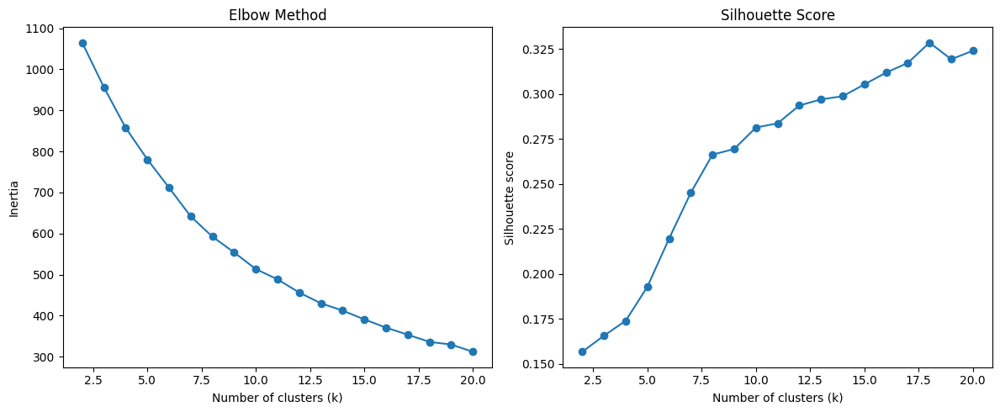

Best k based on silhouette: 18
                                             Feature  Cluster
0               original_shape_Elongation_right_lung       11
1                 original_shape_Flatness_right_lung       11
2          original_shape_LeastAxisLength_right_lung        8
3          original_shape_MajorAxisLength_right_lung       10
4  original_shape_Maximum2DDiameterColumn_right_lung       10
Number of clusters: 18
Selected features: ['log-sigma-2-0-mm-3D_ngtdm_Strength_left_lung', 'log-sigma-3-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-HLH_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-5-0-mm-3D_glrlm_RunEntropy_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Coarseness_right_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmph

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.decomposition import KernelPCA
from sklearn.model_selection import train_test_split

# -----------------------------
# 1. Prepare training data (transpose so features are samples)
# -----------------------------
X_features = X_train_scaled.T   # rows = features, cols = patients

# Standardize
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_features)

# Dimensionality reduction (optional)
pca = KernelPCA(n_components=20, random_state=42, kernel='rbf')
X_pca = pca.fit_transform(X_scaled)

print("Original shape:", X_scaled.shape)
print("Reduced shape:", X_pca.shape)

# -----------------------------
# 2. Evaluate different k values
# -----------------------------
inertias = []
silhouette_scores = []
K_range = range(2, 21)

for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    labels = kmeans.fit_predict(X_pca)
    inertias.append(kmeans.inertia_)
    silhouette_scores.append(silhouette_score(X_pca, labels))

# -----------------------------
# 3. Plot elbow and silhouette
# -----------------------------
fig, ax = plt.subplots(1, 2, figsize=(12, 5))

ax[0].plot(K_range, inertias, marker='o')
ax[0].set_title("Elbow Method")
ax[0].set_xlabel("Number of clusters (k)")
ax[0].set_ylabel("Inertia")

ax[1].plot(K_range, silhouette_scores, marker='o')
ax[1].set_title("Silhouette Score")
ax[1].set_xlabel("Number of clusters (k)")
ax[1].set_ylabel("Silhouette score")

plt.tight_layout()
plt.show()

# -----------------------------
# 4. Choose best k (example: max silhouette)
# -----------------------------
best_k = K_range[np.argmax(silhouette_scores)]
print("Best k based on silhouette:", best_k)

# -----------------------------
# 5. Final clustering with best k (train only)
# -----------------------------
kmeans_final = KMeans(n_clusters=best_k, random_state=42, n_init=10)
final_labels = kmeans_final.fit_predict(X_pca)

clusters = pd.DataFrame({
    "Feature": X_train_scaled.columns,
    "Cluster": final_labels
})

print(clusters.head())

# -----------------------------
# 6. Select representative features per cluster (train only)
# -----------------------------
spearman_corr = X_train_scaled.apply(lambda col: col.corr(y_train, method="spearman"))

selected_features = []
for cluster_id in clusters["Cluster"].unique():
    cluster_feats = clusters.loc[clusters["Cluster"] == cluster_id, "Feature"]
    corrs = spearman_corr.loc[cluster_feats].dropna()
    if not corrs.empty:
        best_feat = corrs.abs().idxmax()
        selected_features.append(best_feat)

print("Number of clusters:", clusters["Cluster"].nunique())
print("Selected features:", selected_features)

# -----------------------------
# 7. Apply selected features to train and test
# -----------------------------
X_train_selected = X_train_scaled[selected_features]
X_test_selected  = X_test[selected_features]

print("Final train shape:", X_train_selected.shape)
print("Final test shape:", X_test_selected.shape)


In [ ]:
import pandas as pd
from statsmodels.stats.outliers_influence import variance_inflation_factor

# -----------------------------
# 8. VIF filtering (train only)
# -----------------------------
X_train_selected_values = X_train_selected.values

vif_data = pd.DataFrame()
vif_data["feature"] = X_train_selected.columns
vif_data["VIF"] = [
    variance_inflation_factor(X_train_selected_values, i)
    for i in range(X_train_selected_values.shape[1])
]

# Keep only features with VIF < 5
low_vif_features = vif_data.loc[vif_data["VIF"] < 10, "feature"].tolist()

print("Selected features (VIF < 10):")
print(low_vif_features)

# -----------------------------
# 9. Final reduced datasets
# -----------------------------
X_train_final = X_train_selected[low_vif_features]
X_test_final  = X_test_selected[low_vif_features]

print("Final train shape:", X_train_final.shape)
print("Final test shape:", X_test_final.shape)

# Optional: inspect VIF table
print("\nVIF table:")
print(vif_data.sort_values("VIF", ascending=False))


Selected features (VIF < 10):
['log-sigma-2-0-mm-3D_ngtdm_Strength_left_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-HLH_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'log-sigma-5-0-mm-3D_glrlm_RunEntropy_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Coarseness_right_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Energy_left_lung', 'wavelet-LHH_ngtdm_Contrast_right_lung', 'wavelet-HHL_ngtdm_Contrast_right_lung', 'wavelet-HLH_ngtdm_Contrast_left_lung']
Final train shape: (454, 11)
Final test shape: (114, 11)

VIF table:
                                              feature        VIF
4   wavelet-LHL_glrlm_GrayLevelNonUniformity_right...  92.213742
11  wavelet-LHL_gldm_GrayLevelNonUniformity_right_...  66.148114
9   log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_rig...  35.142492
17  log-sigma-4-0-mm-3D_glrlm_ShortRunEmphasis_rig...  24.709444
12  original_glrlm

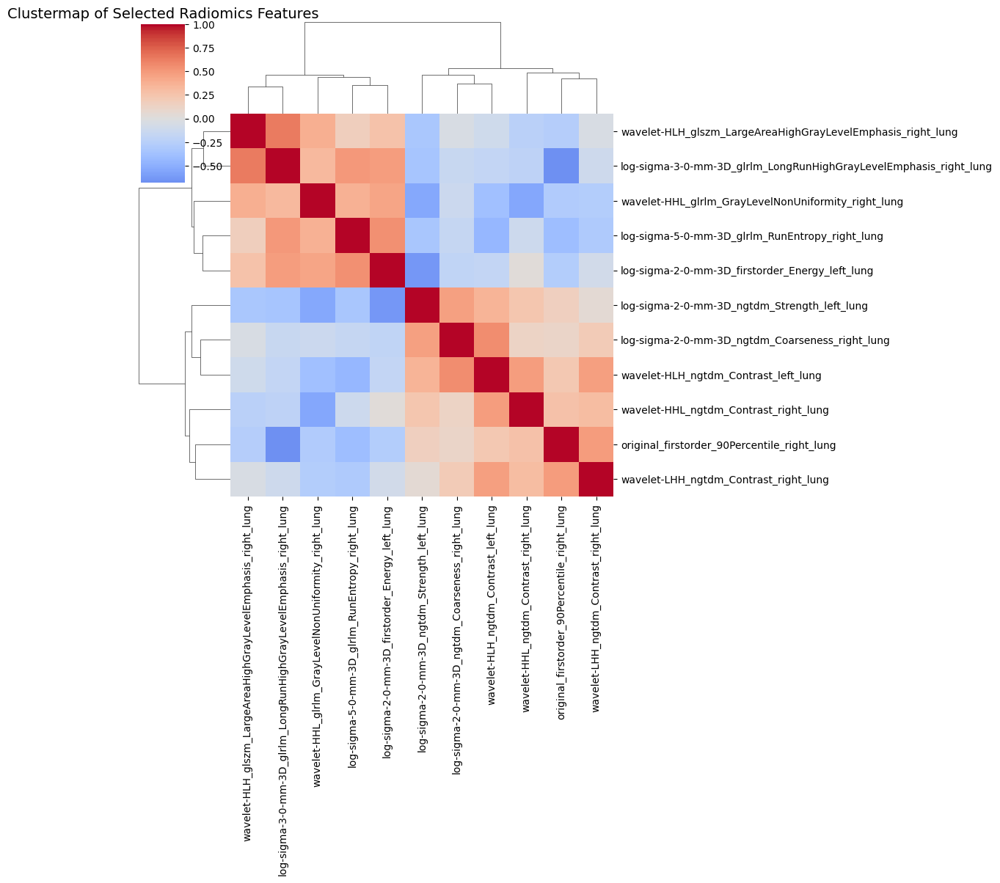

In [ ]:
corr_selected = X_train_final.corr()

# Clustermap of selected features
sns.clustermap(corr_selected, cmap="coolwarm", center=0, figsize=(12, 12))
plt.title("Clustermap of Selected Radiomics Features", fontsize=14)
plt.show()

### corrlation between features and then find another corr between the selected features with Followup FVC

After correlation filter: (454, 288)
After Spearman filter: (454, 32)
Final features: ['original_shape_Maximum2DDiameterRow_right_lung', 'original_shape_MeshVolume_right_lung', 'original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_shape_SurfaceVolumeRatio_right_lung', 'original_firstorder_90Percentile_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'original_ngtdm_Busyness_right_lung', 'wavelet-LLH_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_ngtdm_Busyness_right_lung', 'wavelet-HLL_glrlm_RunLengthNonUniformity_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'log-sigma-1-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Median_right_lung', 'log-sigma-2-0-mm-3D_glcm_Idmn_right_lung', 'log-sigma-2-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmpha

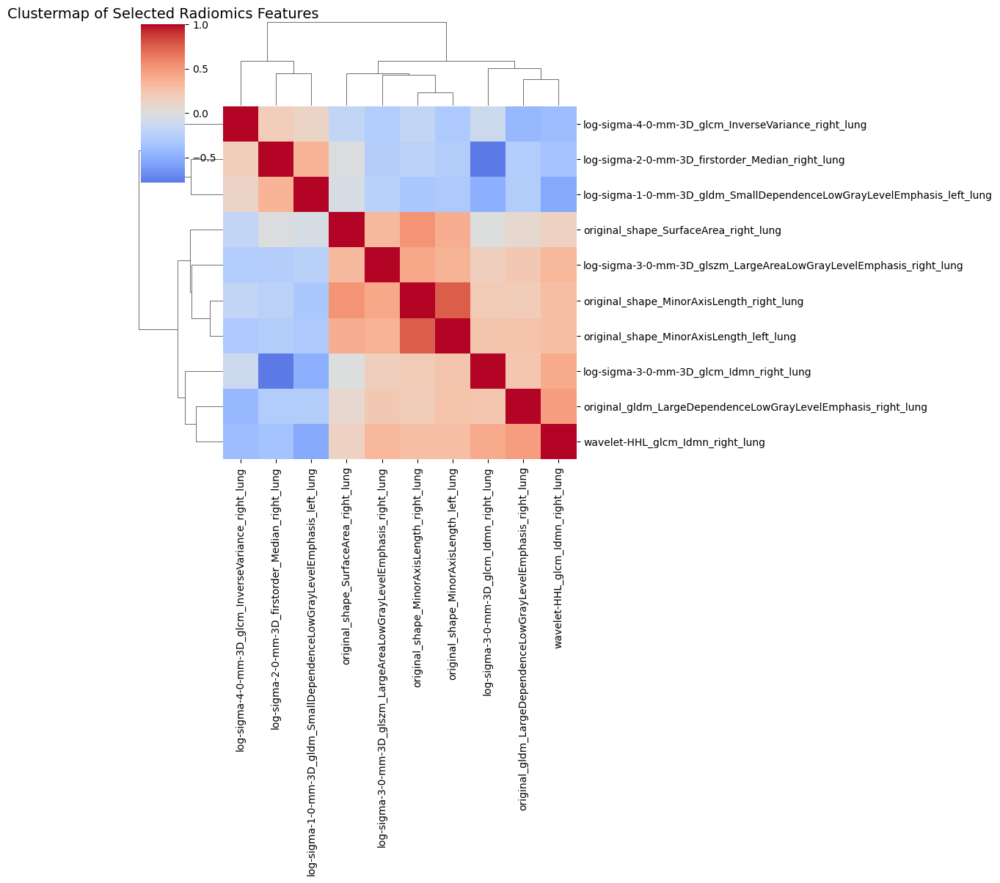

In [ ]:
import numpy as np
import pandas as pd
from sklearn.feature_selection import VarianceThreshold
from statsmodels.stats.outliers_influence import variance_inflation_factor

def feature_selection_on_split(X_train, X_test, y_train, y_test,
                               var_threshold: float = 0.0,
                               corr_threshold: float = 0.9,
                               spearman_threshold: float = 0.4,
                               vif_threshold: float = 10.0):
 

    # -----------------------------
    # 2. Correlation filter
    # -----------------------------
    corr_abs = X_train.corr(method="spearman").abs()
    upper = corr_abs.where(np.triu(np.ones(corr_abs.shape), k=1).astype(bool))
    to_drop = [col for col in upper.columns if any(upper[col] > corr_threshold)]

    X_train_corr = X_train.drop(columns=to_drop)
    X_test_corr = X_test.drop(columns=to_drop)
    print("After correlation filter:", X_train_corr.shape)

    # -----------------------------
    # 3. Spearman correlation with target
    # -----------------------------
    spearman_corr = X_train_corr.apply(lambda col: col.corr(y_train, method="spearman"))
    selected = spearman_corr[abs(spearman_corr) >= spearman_threshold]

    X_train_spear = X_train_corr[selected.index]
    X_test_spear = X_test_corr[selected.index]
    print("After Spearman filter:", X_train_spear.shape)
    print("Final features:", X_train_spear.columns.tolist())
    # -----------------------------
    # 4. VIF filter
    # -----------------------------
    vif_data = pd.DataFrame()
    vif_data["feature"] = X_train_spear.columns
    vif_data["VIF"] = [variance_inflation_factor(X_train_spear.values, i)
                       for i in range(X_train_spear.shape[1])]

    low_vif_features = vif_data.loc[vif_data["VIF"] < vif_threshold, "feature"].tolist()

    X_train_final = X_train_spear[low_vif_features]
    X_test_final = X_test_spear[low_vif_features]
    print("After VIF filter:", X_train_final.shape)

    return X_train_final, X_test_final, vif_data

# Assume you already have X_train, X_test, y_train, y_test
X_train_final, X_test_final, vif_report = feature_selection_on_split(
    X_train_scaled, X_test_scaled, y_train, y_test,
    var_threshold=0.0,
    corr_threshold=0.9,
    spearman_threshold=0.4,
    vif_threshold=10.0
)

print("Final features:", X_train_final.columns.tolist())
print("VIF report:\n", vif_report)
corr_selected = X_train_final.corr()

# Clustermap of selected features
sns.clustermap(corr_selected, cmap="coolwarm", center=0, figsize=(12, 12))
plt.title("Clustermap of Selected Radiomics Features", fontsize=14)
plt.show()


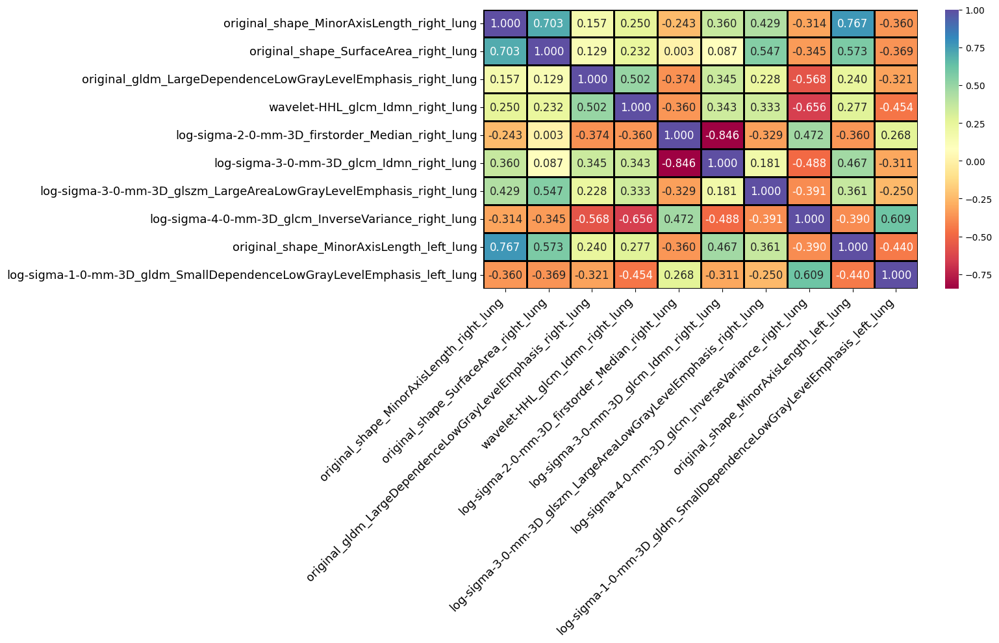

In [ ]:

import matplotlib.pyplot as plt
import seaborn as sns

# 1. Increase the figure size to give the larger text more room
plt.figure(figsize=(16, 10))

# Select the features
features = [
    'original_shape_MinorAxisLength_right_lung', 
    'original_shape_SurfaceArea_right_lung', 
    'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 
    'wavelet-HHL_glcm_Idmn_right_lung', 
    'log-sigma-2-0-mm-3D_firstorder_Median_right_lung', 
    'log-sigma-3-0-mm-3D_glcm_Idmn_right_lung', 
    'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 
    'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 
    'original_shape_MinorAxisLength_left_lung', 
    'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung'
]

# 2. Use 'annot_kws' to increase the font size of the numbers
ax = sns.heatmap(
    framr[features].corr(), 
    annot=True, 
    cmap="Spectral", 
    linewidths=2, 
    linecolor="#000000", 
    fmt='.3f',
    annot_kws={"size": 12}  # Increases size of numbers inside heatmap
)

# 3. Increase font size of feature names (Axis Labels)
# rotation=45 and ha='right' prevents long names from overlapping
plt.xticks(fontsize=13, rotation=45, ha='right')
plt.yticks(fontsize=13)

# 4. Increase Title font size
# plt.title("Correlation Heatmap of Selected Features", fontsize=18, pad=20)

# 5. Use tight_layout to ensure long labels are not cut off at the edges
plt.tight_layout()

plt.show()


After correlation filter: (443, 371)


100%|██████████| 30/30 [00:01<00:00, 20.39it/s]


After mRMR: 30
After mRMR: ['original_gldm_GrayLevelNonUniformity_left_lung', 'log-sigma-2-0-mm-3D_glcm_ClusterProminence_right_lung', 'original_shape_MinorAxisLength_right_lung', 'original_gldm_GrayLevelNonUniformity_right_lung', 'original_shape_MinorAxisLength_left_lung', 'wavelet-LLL_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'original_ngtdm_Busyness_right_lung', 'original_ngtdm_Busyness_left_lung', 'wavelet-LLL_glszm_LargeAreaHighGrayLevelEmphasis_left_lung', 'original_shape_SurfaceArea_right_lung', 'wavelet-LHL_glcm_Idmn_right_lung', 'original_shape_MeshVolume_right_lung', 'log-sigma-2-0-mm-3D_glszm_GrayLevelNonUniformity_right_lung', 'log-sigma-1-0-mm-3D_ngtdm_Busyness_right_lung', 'original_firstorder_Entropy_right_lung', 'original_firstorder_90Percentile_right_lung', 'wavelet-LHL_gldm_SmallDependenceLowGrayLevelEmphasis_right_lung', 'log-sigma-5-0-mm-3D_ngtdm_Busyness_left_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_right_lung', 'original_firstor

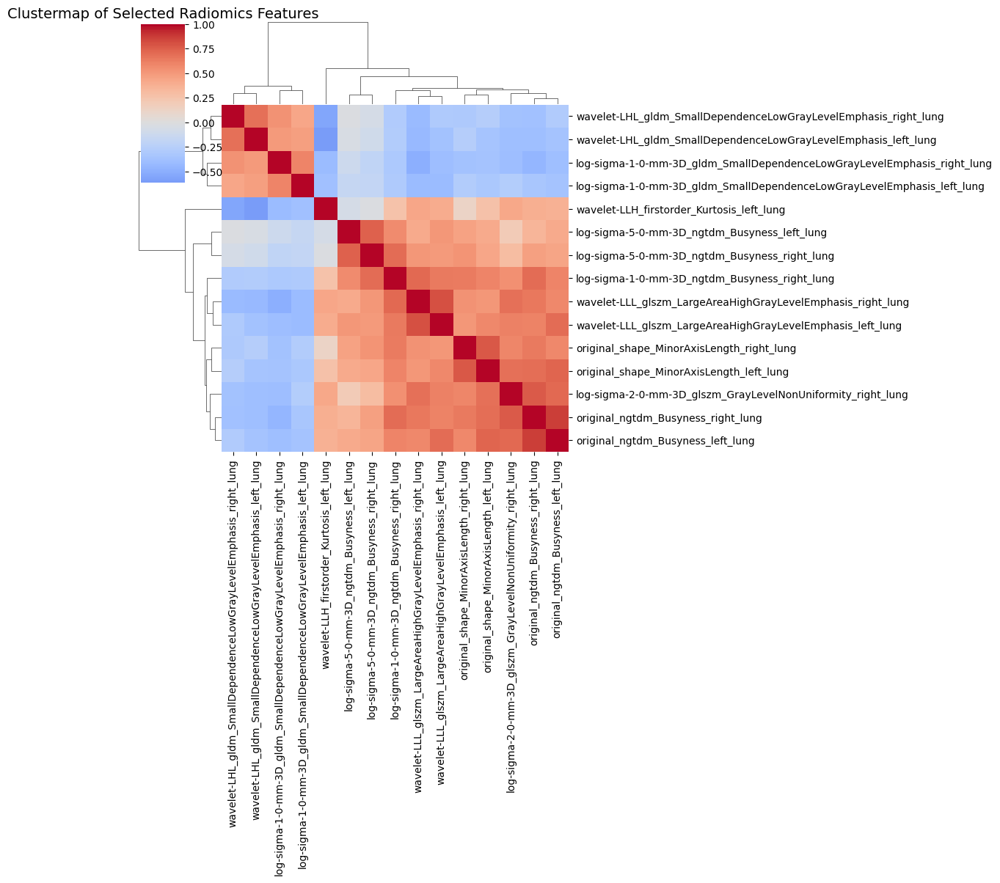

In [ ]:
import numpy as np
import pandas as pd
from sklearn.feature_selection import VarianceThreshold
from statsmodels.stats.outliers_influence import variance_inflation_factor

def feature_selection_on_split(X_train, X_test, y_train, y_test,
                               var_threshold: float = 0.0,
                               corr_threshold: float = 0.9,
                               spearman_threshold: float = 0.4,
                               vif_threshold: float = 10.0):


    # -----------------------------
    # 2. Correlation filter
    # -----------------------------
    corr_abs = X_train.corr(method="spearman").abs()
    upper = corr_abs.where(np.triu(np.ones(corr_abs.shape), k=1).astype(bool))
    to_drop = [col for col in upper.columns if any(upper[col] > corr_threshold)]

    X_train_corr = X_train.drop(columns=to_drop)
    X_test_corr = X_test.drop(columns=to_drop)
    print("After correlation filter:", X_train_corr.shape)

    # -----------------------------
    # 5. mRMR feature selection (train only)
    # -----------------------------
    # Ensure no NaNs
    X_cluster_reps = X_train_corr.fillna(0)

    selected_mrmr = mrmr_regression(
        X=X_cluster_reps,
        y=y_train,
        K=min(30, X_cluster_reps.shape[1])  # choose up to 80 or all available
    )

    print("After mRMR:", len(selected_mrmr))
    print("After mRMR:", selected_mrmr)

    X_train_mrmr = X_cluster_reps[selected_mrmr]
    X_test_mrmr  = X_test[selected_mrmr]  # apply same mask to test
    # -----------------------------
    # 4. VIF filter
    # -----------------------------
    vif_data = pd.DataFrame()
    vif_data["feature"] = X_train_mrmr.columns
    vif_data["VIF"] = [variance_inflation_factor(X_train_mrmr.values, i)
                       for i in range(X_train_mrmr.shape[1])]

    low_vif_features = vif_data.loc[vif_data["VIF"] < vif_threshold, "feature"].tolist()

    X_train_final = X_train_mrmr[low_vif_features]
    X_test_final = X_test_mrmr[low_vif_features]
    print("After VIF filter:", X_train_final.shape)

    return X_train_final, X_test_final, vif_data

# Assume you already have X_train, X_test, y_train, y_test
X_train_final, X_test_final, vif_report = feature_selection_on_split(
    X_train_scaled, X_test_scaled, y_train, y_test,
    var_threshold=0.0,
    corr_threshold=0.9,
    spearman_threshold=0.4,
    vif_threshold=10.0
)

print("Final features:", X_train_final.columns.tolist())
print("VIF report:\n", vif_report)
corr_selected = X_train_final.corr()

# Clustermap of selected features
sns.clustermap(corr_selected, cmap="coolwarm", center=0, figsize=(12, 12))
plt.title("Clustermap of Selected Radiomics Features", fontsize=14)
plt.show()



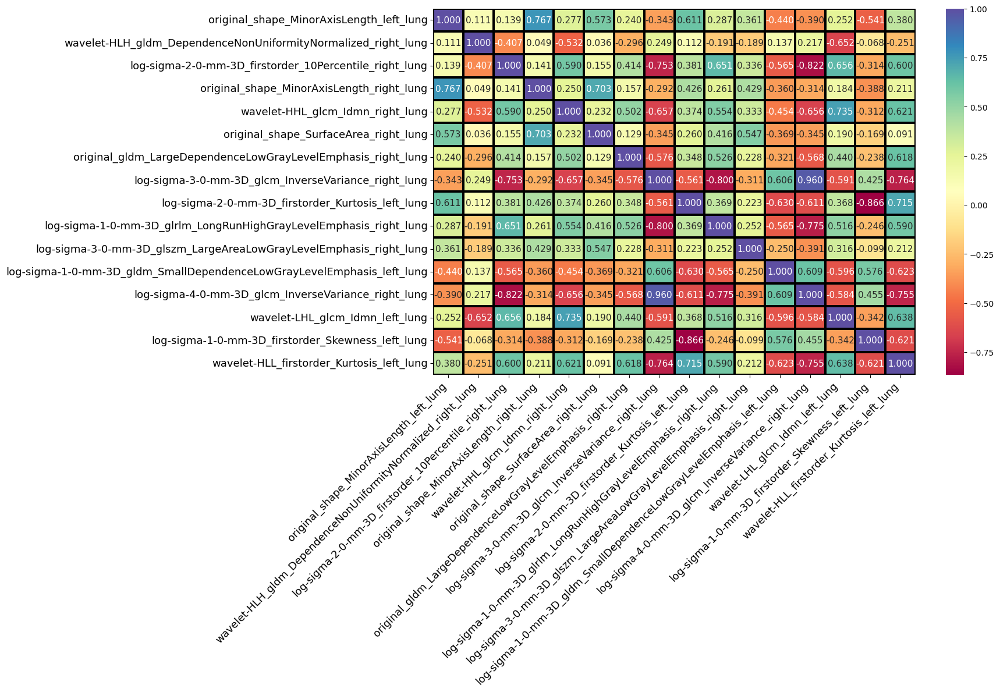

In [ ]:

import matplotlib.pyplot as plt
import seaborn as sns

# 1. Increase figure size for better spacing
plt.figure(figsize=(18, 12))

# List of your selected features
features = [
    'original_shape_MinorAxisLength_left_lung', 
    'wavelet-HLH_gldm_DependenceNonUniformityNormalized_right_lung', 
    'log-sigma-2-0-mm-3D_firstorder_10Percentile_right_lung', 
    'original_shape_MinorAxisLength_right_lung', 
    'wavelet-HHL_glcm_Idmn_right_lung', 
    'original_shape_SurfaceArea_right_lung', 
    'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 
    'log-sigma-3-0-mm-3D_glcm_InverseVariance_right_lung', 
    'log-sigma-2-0-mm-3D_firstorder_Kurtosis_left_lung', 
    'log-sigma-1-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 
    'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 
    'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung', 
    'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 
    'wavelet-LHL_glcm_Idmn_left_lung', 
    'log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung', 
    'wavelet-HLL_firstorder_Kurtosis_left_lung'
]

# 2. Plot heatmap with increased 'annot_kws' for the numbers inside
ax = sns.heatmap(
    framr[features].corr(), 
    annot=True, 
    cmap="Spectral", 
    linewidths=1.5, 
    linecolor="#000000", 
    fmt='.3f',
    annot_kws={"size": 11}  # Font size of numbers inside the boxes
)

# 3. Increase font size of feature names (Axis Labels)
# We use rotation=45 and horizontal alignment 'right' to handle long names
plt.xticks(fontsize=13, rotation=45, ha='right')
plt.yticks(fontsize=13)

# 4. Increase Title font size
# plt.title("Correlation Heatmap of Selected Features", fontsize=18, pad=25)

# 5. Tight layout is essential to prevent long labels from being cut off
plt.tight_layout()

plt.show()

After ANOVA: 30
After ANOVA: ['original_shape_MinorAxisLength_right_lung', 'original_firstorder_Energy_right_lung', 'original_firstorder_TotalEnergy_right_lung', 'original_glrlm_GrayLevelNonUniformity_right_lung', 'original_gldm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LLL_firstorder_Energy_right_lung', 'wavelet-LLL_firstorder_TotalEnergy_right_lung', 'wavelet-LLL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LLL_gldm_GrayLevelNonUniformity_right_lung', 'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-1-0-mm-3D_gldm_GrayLevelNonUniformity_right_lung', 'log-sigma-2-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_gldm_GrayLevelNonUniformity_right_lung', 'log-sigma-3-0-mm-3D_gldm_GrayLevelNonUniformity_right_lung', 'log-sigma-4-0-mm-3D_gldm_GrayLevelNonUniformity_right_lung', 'log-sigma-5-0-mm-3D_firstorder_Energy_right_lung', 'log-sigma-5-0-mm-3D_firstorder_TotalEnergy_

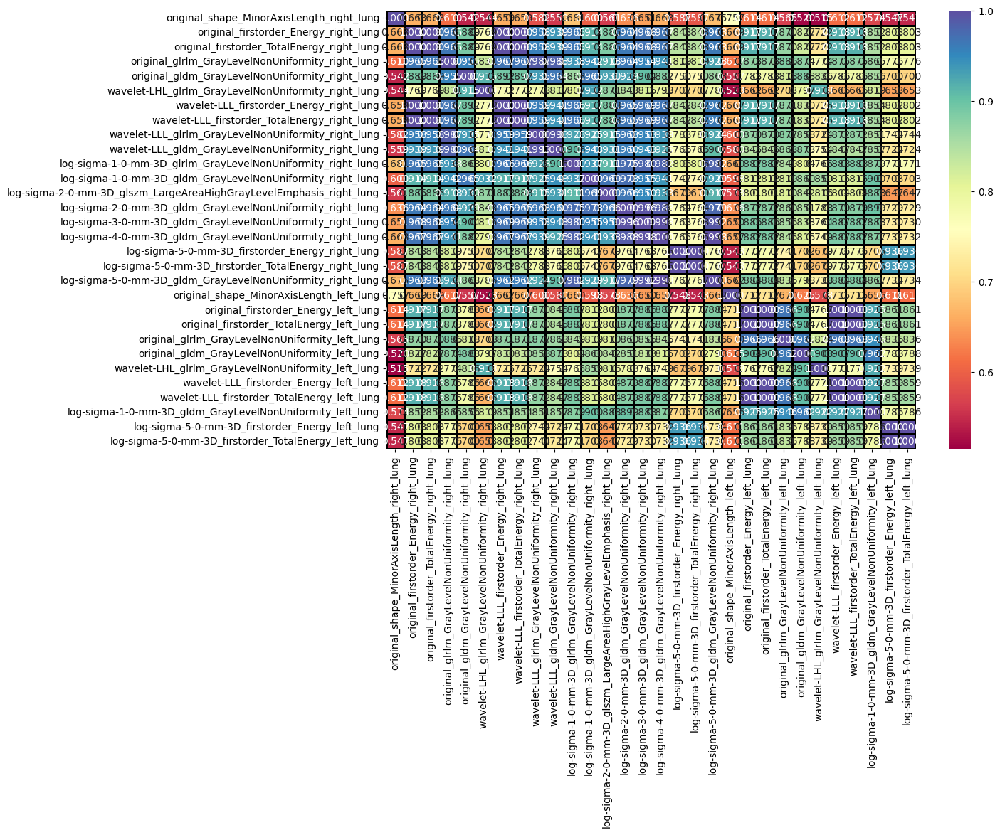

In [ ]:
#remove
from sklearn.feature_selection import SelectKBest, f_regression
import pandas as pd

# -----------------------------
# 5. ANOVA feature selection (train only)
# -----------------------------
selector = SelectKBest(score_func=f_regression, k=min(30, X_train_scaled.shape[1]))

# Fit selector on training data
X_train_anova = selector.fit_transform(X_train_scaled, y_train)
X_test_anova  = selector.transform(X_test_scaled)

# Get selected feature names from the DataFrame columns
anova_features = X_train_scaled.columns[selector.get_support()].tolist()
print("After ANOVA:", len(anova_features))
print("After ANOVA:", anova_features)

# -----------------------------
# 6. VIF filtering (train only)
# -----------------------------
X_train_anova_df = pd.DataFrame(X_train_anova, columns=anova_features, index=X_train.index)
X_test_anova_df  = pd.DataFrame(X_test_anova,  columns=anova_features, index=X_test.index)


plt.figure(figsize = (12, 8))
sns.heatmap(X_train_scaled[anova_features].corr(), annot = True, cmap = "Spectral", linewidths = 2, linecolor = "#000000", fmt='.3f')
plt.show()


100%|██████████| 30/30 [00:05<00:00,  5.49it/s]


After mRMR: 30
After mRMR: ['original_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_glrlm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_right_lung', 'original_shape_MinorAxisLength_left_lung', 'log-sigma-5-0-mm-3D_firstorder_Energy_left_lung', 'log-sigma-2-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_left_lung', 'original_glrlm_GrayLevelNonUniformity_left_lung', 'log-sigma-5-0-mm-3D_firstorder_TotalEnergy_left_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-2-0-mm-3D_gldm_GrayLevelNonUniformity_right_lung', 'original_gldm_GrayLevelNonUniformity_left_lung', 'log-sigma-5-0-mm-3D_firstorder_Energy_right_lung', 'original_firstorder_Energy_right_lung', 'original_gldm_GrayLevelNonUniformity_right_lung', 'log-sigma-5-0-mm-3D_firstorder_TotalEnergy_right_lung', 'log-sigma-3-0-mm-3D_gldm_GrayLevelNonUniformity_right_lung', 'original_firstorder_TotalEnergy_right_lung', 'log-sigma-1-0-mm-3D_gl

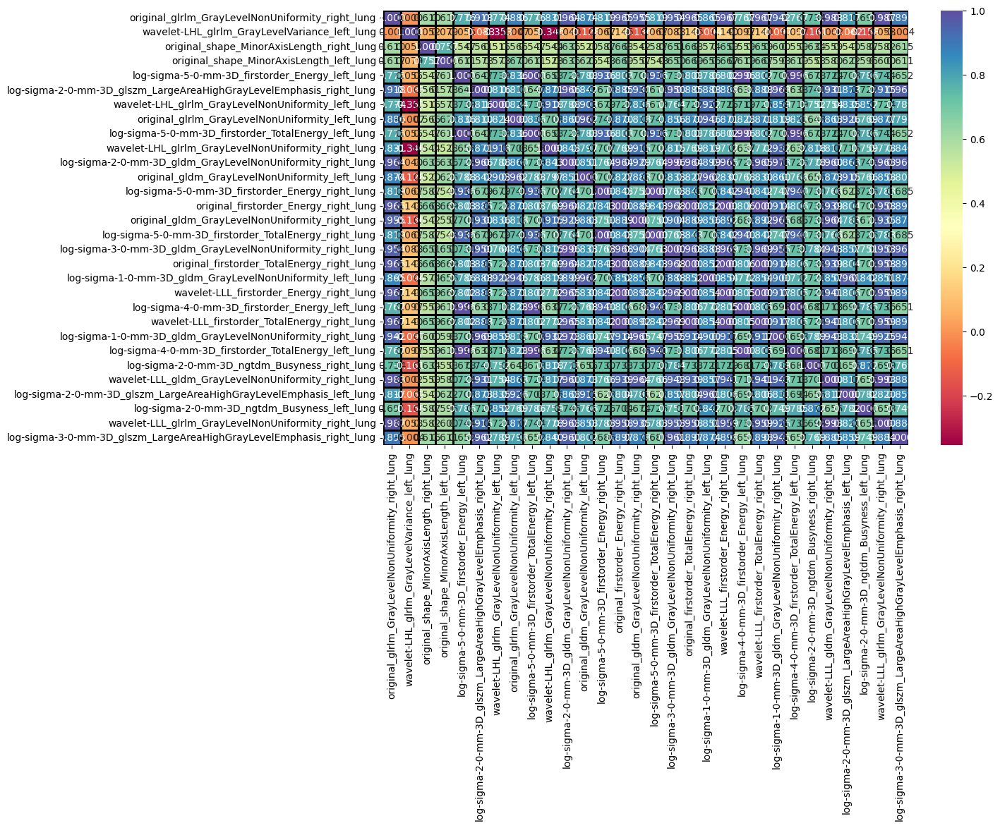

In [ ]:
# -----------------------------
# 5. mRMR feature selection (train only)
# -----------------------------
# Ensure no NaNs

selected_mrmr = mrmr_regression(
    X=X_train_scaled,
    y=y_train,
    K=min(30, X_train_scaled.shape[1])  # choose up to 80 or all available
)

print("After mRMR:", len(selected_mrmr))
print("After mRMR:", selected_mrmr)
X_train_mrmr = X_train_scaled[selected_mrmr]
X_test_mrmr  = X_test[selected_mrmr] 

plt.figure(figsize = (12, 8))
sns.heatmap(X_train_scaled[selected_mrmr].corr(), annot = True, cmap = "Spectral", linewidths = 2, linecolor = "#000000", fmt='.3f')
plt.show()

In [ ]:
vif_data = pd.DataFrame()
vif_data["feature"] = X_train_scaled.columns
vif_data["VIF"] = [variance_inflation_factor(X_train_scaled.values, i)
                    for i in range(X_train_scaled.shape[1])]

low_vif_features = vif_data.loc[vif_data["VIF"] < 5, "feature"].tolist()

X_train_final = X_train_scaled[low_vif_features]
X_test_final = X_test_mrmr[low_vif_features]
print("After VIF filter:", X_train_final.shape)

KeyboardInterrupt: 